In [1]:
import tensorflow as tf
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout

import pandas as pd
import pandas_ta as ta
import pandas_datareader.data as web
import numpy as np

import time as tm
import datetime as dt

import yfinance as yf
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import statsmodels.api as sm
from statsmodels.regression.rolling import RollingOLS
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, MaxAbsScaler
from collections import deque

In [2]:
STOCKS = pd.read_html('https://en.wikipedia.org/wiki/List_of_S%26P_500_companies')[0]
STOCKS

,Symbol,Security,GICS Sector,GICS Sub-Industry,Headquarters Location,Date added,CIK,Founded
0,MMM,3M,Industrials,Industrial Conglomerates,"Saint Paul, Minnesota",1957-03-04,66740,1902
1,AOS,A. O. Smith,Industrials,Building Products,"Milwaukee, Wisconsin",2017-07-26,91142,1916
2,ABT,Abbott,Health Care,Health Care Equipment,"North Chicago, Illinois",1957-03-04,1800,1888
3,ABBV,AbbVie,Health Care,Biotechnology,"North Chicago, Illinois",2012-12-31,1551152,2013 (1888)
4,ACN,Accenture,Information Technology,IT Consulting & Other Services,"Dublin, Ireland",2011-07-06,1467373,1989
...,...,...,...,...,...,...,...,...
498,YUM,Yum! Brands,Consumer Discretionary,Restaurants,"Louisville, Kentucky",1997-10-06,1041061,1997
499,ZBRA,Zebra Technologies,Information Technology,Electronic Equipment & Instruments,"Lincolnshire, Illinois",2019-12-23,877212,1969
500,ZBH,Zimmer Biomet,Health Care,Health Care Equipment,"Warsaw, Indiana",2001-08-07,1136869,1927
501,ZION,Zions Bancorporation,Financials,Regional Banks,"Salt Lake City, Utah",2001-06-22,109380,1873


In [3]:
STOCKS['Symbol'] = STOCKS['Symbol'].str.replace('.', '-')

ST_list = STOCKS['Symbol'].unique().tolist()

cur_date = (dt.date.today()).strftime('%Y-%m-%d')
init_date = (dt.date.today() - dt.timedelta(days=365*10)).strftime('%Y-%m-%d')

df = yf.download(tickers=ST_list,
                start=init_date,
                end = cur_date).stack()
df.index.names = ['date','ticker']
df

[*********************100%%**********************]  503 of 503 completed


Adj Close       Close        High         Low        Open  \
date       ticker                                                               
2014-01-21 A        39.982552   43.526466   43.547928   42.818314   43.412018   
           AAL      28.904451   30.660000   30.799999   30.200001   30.660000   
           AAPL     17.191612   19.609644   19.645357   19.300714   19.321072   
           ABBV     33.140087   50.000000   50.919998   49.910000   50.259998   
           ABT      32.279087   39.119999   39.570000   38.860001   39.520000   
...                       ...         ...         ...         ...         ...   
2024-01-12 YUM     129.130005  129.130005  129.479996  128.320007  129.479996   
           ZBH     123.070000  123.070000  124.750000  122.349998  123.690002   
           ZBRA    248.869995  248.869995  259.170013  243.559998  256.769989   
           ZION     42.110001   42.110001   43.660000   41.799999   43.580002   
           ZTS     198.940002  198.940002  199.559998  196.869995  197.679993   

                        Volume  
date       ticker               
2014-01-21 A         4205883.0  
           AAL      10612500.0  
           AAPL    328526800.0  
           ABBV      5823000.0  
           ABT       8229600.0  
...                        ...  
2024-01-12 YUM       1080800.0  
           ZBH       1735800.0  
           ZBRA       625600.0  
           ZION      1713500.0  
           ZTS       1726500.0  

[1233640 rows x 6 columns]

In [4]:
# calculate RSI
df['Rsi'] = df.groupby(level=1)['Adj Close'].transform(ta.rsi, length=15)

#calculate MACD
def compute_macd(closing_prices):
    macd_values = ta.macd(close=closing_prices, length=15).iloc[:,0]
    return(macd_values - macd_values.mean())/macd_values.std()
df['Macd'] = df.groupby(level=1, group_keys=False)['Adj Close'].transform(compute_macd)

# Calculate ATR
def compute_atr(price_data):
    avg_true_range = ta.atr(
        high = price_data['High'],
        low = price_data['Low'],
        close = price_data['Close'],
        length = 14)
    return (avg_true_range - avg_true_range.mean()) / avg_true_range.std()
df['Atr'] = df.groupby(level=1, group_keys=False).apply(compute_atr)

# calculate daily trade dollar value in millions
df['Dollar_value_traded_mill'] = np.multiply(df['Adj Close'], df['Volume']) / 1e6
df

Adj Close       Close        High         Low        Open  \
date       ticker                                                               
2014-01-21 A        39.982552   43.526466   43.547928   42.818314   43.412018   
           AAL      28.904451   30.660000   30.799999   30.200001   30.660000   
           AAPL     17.191612   19.609644   19.645357   19.300714   19.321072   
           ABBV     33.140087   50.000000   50.919998   49.910000   50.259998   
           ABT      32.279087   39.119999   39.570000   38.860001   39.520000   
...                       ...         ...         ...         ...         ...   
2024-01-12 YUM     129.130005  129.130005  129.479996  128.320007  129.479996   
           ZBH     123.070000  123.070000  124.750000  122.349998  123.690002   
           ZBRA    248.869995  248.869995  259.170013  243.559998  256.769989   
           ZION     42.110001   42.110001   43.660000   41.799999   43.580002   
           ZTS     198.940002  198.940002  199.559998  196.869995  197.679993   

                        Volume        Rsi      Macd       Atr  \
date       ticker                                               
2014-01-21 A         4205883.0        NaN       NaN       NaN   
           AAL      10612500.0        NaN       NaN       NaN   
           AAPL    328526800.0        NaN       NaN       NaN   
           ABBV      5823000.0        NaN       NaN       NaN   
           ABT       8229600.0        NaN       NaN       NaN   
...                        ...        ...       ...       ...   
2024-01-12 YUM       1080800.0  53.640902  0.168474  0.075531   
           ZBH       1735800.0  68.594051  0.821875 -0.615684   
           ZBRA       625600.0  46.284606  0.347451  0.312750   
           ZION      1713500.0  51.313284  1.171177  0.503484   
           ZTS       1726500.0  64.369105  1.451610  0.663847   

                   Dollar_value_traded_mill  
date       ticker                            
2014-01-21 A                     168.161934  
           AAL                   306.748490  
           AAPL                 5647.905357  
           ABBV                  192.974727  
           ABT                   265.643975  
...                                     ...  
2024-01-12 YUM                   139.563709  
           ZBH                   213.624905  
           ZBRA                  155.693069  
           ZION                   72.155486  
           ZTS                   343.469914  

[1233640 rows x 10 columns]

In [5]:
non_price_cols = [col for col in df.columns.unique(0) if col not in ['Dollar_value_traded_mill', 'Volume', 'Open', 'High', 'Low', 'Close']]

# Combine resampling and stacking for efficiency
monthly_dollar_volume = (
    df.unstack('ticker')['Dollar_value_traded_mill']
      .resample('M').mean()
      .stack('ticker')
      .to_frame(name='monthly_dollar_volume_mill')  # Clearer column name
)

monthly_other_data = (
    df.unstack()[non_price_cols]
      .resample('M').last()
      .stack('ticker')
)

# Concatenate and handle missing values
monthly_data = pd.concat([monthly_dollar_volume, monthly_other_data], axis=1).dropna()

smoothed_5yr_dollar_volume = (
    monthly_data.loc[:, 'monthly_dollar_volume_mill'].unstack('ticker')
        .rolling(window=5*12, min_periods=12).mean()
        .stack())

# Faster ranking method
monthly_data['5yr_dollar_vol_rank'] = (
    monthly_data.groupby('date')['monthly_dollar_volume_mill'].rank(method='first', ascending=False))

# Combine filtering for top 50 high volume stocks and dropping for efficiency
filtered_data = monthly_data[monthly_data['5yr_dollar_vol_rank'] < 50].drop(columns=['monthly_dollar_volume_mill', '5yr_dollar_vol_rank'])
filtered_data

Adj Close        Rsi      Macd       Atr
date       ticker                                           
2014-02-28 AAPL     16.575417  47.572371 -0.242491 -0.967079
           AIG      39.503738  54.498076  0.191479 -0.486242
           AMZN     18.105000  46.127863 -0.346389 -1.046869
           BA      110.805710  46.208735 -0.178638 -0.902826
           BAC      13.662596  47.834200 -0.255835 -1.177805
...                       ...        ...       ...       ...
2024-01-31 V       264.170013  66.809423  0.996618 -0.093538
           VZ       38.560001  58.839663  1.343768 -0.244801
           WFC      47.400002  46.797256  0.965962 -0.214344
           WMT     161.320007  61.893200  0.711942  0.122688
           XOM      99.949997  44.746101 -0.712297  0.377890

[5880 rows x 4 columns]

In [6]:
def calculate_monthly_returns_with_outlier_clipping(group_df):
    # threshold for outlier detection; clip values below the 1th percentile and above the 99th percentile
    outlier_percentile = 0.01
    lags_in_months = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

    for lag in lags_in_months:
        returns = (
            group_df['Adj Close'].pct_change(lag)
            .pipe(lambda x: x.clip(lower=x.quantile(outlier_percentile),
                                    upper=x.quantile(1-outlier_percentile)))
            .add(1)
            .pow(1 / lag)
            .sub(1)
        )
        group_df[f'annualized_return_{lag}m'] = returns

    return group_df

filtered_data_with_returns = filtered_data.groupby(level=1, group_keys=False).apply(calculate_monthly_returns_with_outlier_clipping).dropna()
filtered_data_with_returns

Adj Close        Rsi      Macd       Atr  \
date       ticker                                               
2015-02-28 AAPL      28.860918  62.321997  0.275120 -0.772142   
           AMZN      19.007999  66.697322  0.184948 -1.088650   
           BAC       13.162427  42.788940 -0.143414 -0.883154   
           BKNG    1237.479980  73.442929  1.170220 -0.890587   
           C         41.628269  62.073334  0.421054 -0.787228   
...                        ...        ...       ...       ...   
2024-01-31 V        264.170013  66.809423  0.996618 -0.093538   
           VZ        38.560001  58.839663  1.343768 -0.244801   
           WFC       47.400002  46.797256  0.965962 -0.214344   
           WMT      161.320007  61.893200  0.711942  0.122688   
           XOM       99.949997  44.746101 -0.712297  0.377890   

                   annualized_return_1m  annualized_return_2m  \
date       ticker                                               
2015-02-28 AAPL                0.100776              0.080921   
           AMZN                0.072293              0.106770   
           BAC                 0.043565             -0.059929   
           BKNG                0.225859              0.041782   
           C                   0.116507             -0.015636   
...                                 ...                   ...   
2024-01-31 V                   0.014673              0.014485   
           VZ                  0.116147              0.084017   
           WFC                -0.036977              0.100302   
           WMT                 0.023280              0.019809   
           XOM                -0.000300             -0.013671   

                   annualized_return_3m  annualized_return_4m  \
date       ticker                                               
2015-02-28 AAPL                0.027375              0.046486   
           AMZN                0.039304              0.056217   
           BAC                -0.023715             -0.019561   
           BKNG                0.021731              0.006419   
           C                  -0.009596             -0.005172   
...                                 ...                   ...   
2024-01-31 V                   0.040363              0.035774   
           VZ                 -0.001054              0.016649   
           WFC                 0.069107              0.067678   
           WMT                -0.003050              0.003095   
           XOM                -0.015955             -0.037611   

                   annualized_return_5m  annualized_return_6m  \
date       ticker                                               
2015-02-28 AAPL                0.051532              0.039774   
           AMZN                0.033483              0.019262   
           BAC                -0.014413             -0.001924   
           BKNG                0.013264             -0.000917   
           C                   0.002386              0.002537   
...                                 ...                   ...   
2024-01-31 V                   0.015050              0.018411   
           VZ                  0.024075              0.020156   
           WFC                 0.008448              0.028536   
           WMT                -0.000851              0.005558   
           XOM                -0.019305             -0.008816   

                   annualized_return_7m  annualized_return_8m  \
date       ticker                                               
2015-02-28 AAPL                0.045083              0.043025   
           AMZN                0.028164              0.019875   
           BAC                 0.006027              0.004287   
           BKNG               -0.000572              0.003539   
           C                   0.010008              0.013543   
...                                 ...                   ...   
2024-01-31 V                   0.015913              0.023049   
           VZ                  0.003347             

In [7]:
monthly_factors = (
    web.DataReader('F-F_Research_Data_5_Factors_2x3', 'famafrench', start='2014')[0].drop('RF', axis=1))
print(monthly_factors)

monthly_factors.index = monthly_factors.index.to_timestamp()
#print(monthly_factors.index)
monthly_factors = monthly_factors.resample('M').last().div(100)
# print(monthly_factors)
monthly_factors.index.name = 'date'
# print(monthly_factors)
# Combine with returns and sort efficiently
combined_data = monthly_factors.join(filtered_data_with_returns['annualized_return_1m']).sort_index(kind='mergesort')

# count entries per stock
entries = combined_data.groupby(level=1).size()

# filter through only the stocks with 10 or more entries
valid_list = entries[entries >= 10]
combined_data = combined_data[combined_data.index.get_level_values('ticker').isin(valid_list.index)]
combined_data

         Mkt-RF   SMB   HML   RMW   CMA
Date                                   
2014-01   -3.32  0.58 -2.07 -3.88 -1.42
2014-02    4.65  0.14 -0.31 -0.23 -0.45
2014-03    0.43 -1.09  4.93  2.13  1.92
2014-04   -0.19 -4.12  1.17  3.48  1.02
2014-05    2.06 -1.89 -0.13  0.05 -1.00
...         ...   ...   ...   ...   ...
2023-07    3.21  2.86  4.11 -0.57  0.57
2023-08   -2.39 -3.65 -1.06  3.43 -2.37
2023-09   -5.24 -1.80  1.52  1.86 -0.83
2023-10   -3.19 -4.04  0.19  2.46 -0.66
2023-11    8.84 -0.10  1.65 -3.89 -0.99

[119 rows x 5 columns]


C:\Users\Usuario\AppData\Local\Temp\ipykernel_24884\3802558637.py:2: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  web.DataReader('F-F_Research_Data_5_Factors_2x3', 'famafrench', start='2014')[0].drop('RF', axis=1))
C:\Users\Usuario\AppData\Local\Temp\ipykernel_24884\3802558637.py:2: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  web.DataReader('F-F_Research_Data_5_Factors_2x3', 'famafrench', start='2014')[0].drop('RF', axis=1))


Mkt-RF     SMB     HML     RMW     CMA  \
date       ticker                                           
2015-02-28 AAPL    0.0613  0.0032 -0.0186 -0.0112 -0.0182   
           AMZN    0.0613  0.0032 -0.0186 -0.0112 -0.0182   
           BAC     0.0613  0.0032 -0.0186 -0.0112 -0.0182   
           BKNG    0.0613  0.0032 -0.0186 -0.0112 -0.0182   
           C       0.0613  0.0032 -0.0186 -0.0112 -0.0182   
...                   ...     ...     ...     ...     ...   
2023-11-30 UBER    0.0884 -0.0010  0.0165 -0.0389 -0.0099   
           UNH     0.0884 -0.0010  0.0165 -0.0389 -0.0099   
           V       0.0884 -0.0010  0.0165 -0.0389 -0.0099   
           WMT     0.0884 -0.0010  0.0165 -0.0389 -0.0099   
           XOM     0.0884 -0.0010  0.0165 -0.0389 -0.0099   

                   annualized_return_1m  
date       ticker                        
2015-02-28 AAPL                0.100776  
           AMZN                0.072293  
           BAC                 0.043565  
           BKNG                0.225859  
           C                   0.116507  
...                                 ...  
2023-11-30 UBER                0.225919  
           UNH                 0.032508  
           V                   0.094115  
           WMT                -0.047243  
           XOM                -0.020506  

[4453 rows x 6 columns]

In [8]:
# Calculate time-varying factor betas (optimized for efficiency)
betas = combined_data.groupby(level=1)['annualized_return_1m'].rolling(
    window=min(24, combined_data.shape[0]), min_nobs=combined_data.shape[1] + 1
).apply(
    lambda x: RollingOLS(endog=x['annualized_return_1m'], 
                                     exog=sm.add_constant(x.drop('annualized_return_1m', axis=1)),
                                     window=min(24, x.shape[0]),
                                     min_nobs=len(x.columns)+1)
                                    .fit(params_only=True).params.drop('const', axis=1))

# Join betas with data and handle missing values (optimized)
factor_names = ['Mkt-RF', 'SMB', 'HML', 'RMW', 'CMA']
filtered_data_with_returns = filtered_data_with_returns.join(betas.groupby('ticker').shift(), on='ticker')

# Efficiently fill missing values with mean within groups
filtered_data_with_returns[factor_names] = filtered_data_with_returns.groupby('ticker')[factor_names].transform(lambda x: x.fillna(x.mean()))

# Drop unnecessary columns and rows with missing values
filtered_data_with_returns = filtered_data_with_returns.drop('Adj Close', axis=1).dropna()

# Data overview
filtered_data_with_returns.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 4605 entries, (Timestamp('2015-02-28 00:00:00'), 'AAPL') to (Timestamp('2024-01-31 00:00:00'), 'XOM')
Data columns (total 20 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Rsi                    4605 non-null   float64
 1   Macd                   4605 non-null   float64
 2   Atr                    4605 non-null   float64
 3   annualized_return_1m   4605 non-null   float64
 4   annualized_return_2m   4605 non-null   float64
 5   annualized_return_3m   4605 non-null   float64
 6   annualized_return_4m   4605 non-null   float64
 7   annualized_return_5m   4605 non-null   float64
 8   annualized_return_6m   4605 non-null   float64
 9   annualized_return_7m   4605 non-null   float64
 10  annualized_return_8m   4605 non-null   float64
 11  annualized_return_9m   4605 non-null   float64
 12  annualized_return_10m  4605 non-null   float64
 13  annualized_return_11m  4605 no

In [9]:
def assign_clusters(dataframe):
    kmeans = KMeans(n_clusters=5,
                    random_state=0,
                    init='random')
    dataframe['Cluster'] = kmeans.fit_predict(dataframe) #C
    return dataframe

data_with_clusters = (filtered_data_with_returns.dropna().groupby('date', group_keys=False).apply(assign_clusters))


data_with_clusters

C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change fr

Rsi      Macd       Atr  annualized_return_1m  \
date       ticker                                                        
2015-02-28 AAPL    62.321997  0.275120 -0.772142              0.100776   
           AMZN    66.697322  0.184948 -1.088650              0.072293   
           BAC     42.788940 -0.143414 -0.883154              0.043565   
           BKNG    73.442929  1.170220 -0.890587              0.225859   
           C       62.073334  0.421054 -0.787228              0.116507   
...                      ...       ...       ...                   ...   
2024-01-31 V       66.809423  0.996618 -0.093538              0.014673   
           VZ      58.839663  1.343768 -0.244801              0.116147   
           WFC     46.797256  0.965962 -0.214344             -0.036977   
           WMT     61.893200  0.711942  0.122688              0.023280   
           XOM     44.746101 -0.712297  0.377890             -0.000300   

                   annualized_return_2m  annualized_return_3m  \
date       ticker                                               
2015-02-28 AAPL                0.080921              0.027375   
           AMZN                0.106770              0.039304   
           BAC                -0.059929             -0.023715   
           BKNG                0.041782              0.021731   
           C                  -0.015636             -0.009596   
...                                 ...                   ...   
2024-01-31 V                   0.014485              0.040363   
           VZ                  0.084017             -0.001054   
           WFC                 0.100302              0.069107   
           WMT                 0.019809             -0.003050   
           XOM                -0.013671             -0.015955   

                   annualized_return_4m  annualized_return_5m  \
date       ticker                                               
2015-02-28 AAPL                0.046486              0.051532   
           AMZN                0.056217              0.033483   
           BAC                -0.019561             -0.014413   
           BKNG                0.006419              0.013264   
           C                  -0.005172              0.002386   
...                                 ...                   ...   
2024-01-31 V                   0.035774              0.015050   
           VZ                  0.016649              0.024075   
           WFC                 0.067678              0.008448   
           WMT                 0.003095             -0.000851   
           XOM                -0.037611             -0.019305   

                   annualized_return_6m  annualized_return_7m  ...  \
date       ticker                                              ...   
2015-02-28 AAPL                0.039774              0.045083  ...   
           AMZN                0.019262              0.028164  ...   
           BAC                -0.001924              0.006027  ...   
           BKNG               -0.000917             -0.000572  ...   
           C                   0.002537              0.010008  ...   
...                                 ...                   ...  ...   
2024-01-31 V                   0.018411              0.015913  ...   
           VZ                  0.020156              0.003347  ...   
           WFC                 0.028536              0.017507  ...   
           WMT                 0.005558              0.014547  ...   
           XOM                -0.008816             -0.007575  ...   

                   annualized_return_9m  annualized_return_10m  \
date       ticker                                                
2015-02-28 AAPL                0.041306               0.044988   
           AMZN                0.021997               0.022565   
           BAC                 0.005565               0.005007   
           BKNG               -0.003628               0.006682   
           C                   0.010913               0.009119 

In [11]:
# RSI under 30 means oversold and over 70 overbought therefore indicating potential issues.
target_centroids = [30, 40, 50, 60, 70]

fix_centroids = np.zeros((len(target_centroids), 20))
fix_centroids[:, 7] = target_centroids

# fix_centroids

data_with_clusters = data_with_clusters.drop('Cluster', axis=1) #C

def assign_clusters(dataframe):
    kmeans = KMeans(n_clusters=5,
                    random_state=0,
                    init=fix_centroids)
    dataframe['Cluster'] = kmeans.fit_predict(dataframe) #C
    return dataframe

data_with_clusters = (filtered_data_with_returns.dropna().groupby('date', group_keys=False).apply(assign_clusters))


data_with_clusters

C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: RuntimeWarning: Explicit initial center position passed: performing only one init in KMeans instead of n_init=10.
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\Usuario\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:1416: RuntimeWarning: Explicit initial center position passed: performing only one init in KMea

Rsi      Macd       Atr  annualized_return_1m  \
date       ticker                                                        
2015-02-28 AAPL    62.321997  0.275120 -0.772142              0.100776   
           AMZN    66.697322  0.184948 -1.088650              0.072293   
           BAC     42.788940 -0.143414 -0.883154              0.043565   
           BKNG    73.442929  1.170220 -0.890587              0.225859   
           C       62.073334  0.421054 -0.787228              0.116507   
...                      ...       ...       ...                   ...   
2024-01-31 V       66.809423  0.996618 -0.093538              0.014673   
           VZ      58.839663  1.343768 -0.244801              0.116147   
           WFC     46.797256  0.965962 -0.214344             -0.036977   
           WMT     61.893200  0.711942  0.122688              0.023280   
           XOM     44.746101 -0.712297  0.377890             -0.000300   

                   annualized_return_2m  annualized_return_3m  \
date       ticker                                               
2015-02-28 AAPL                0.080921              0.027375   
           AMZN                0.106770              0.039304   
           BAC                -0.059929             -0.023715   
           BKNG                0.041782              0.021731   
           C                  -0.015636             -0.009596   
...                                 ...                   ...   
2024-01-31 V                   0.014485              0.040363   
           VZ                  0.084017             -0.001054   
           WFC                 0.100302              0.069107   
           WMT                 0.019809             -0.003050   
           XOM                -0.013671             -0.015955   

                   annualized_return_4m  annualized_return_5m  \
date       ticker                                               
2015-02-28 AAPL                0.046486              0.051532   
           AMZN                0.056217              0.033483   
           BAC                -0.019561             -0.014413   
           BKNG                0.006419              0.013264   
           C                  -0.005172              0.002386   
...                                 ...                   ...   
2024-01-31 V                   0.035774              0.015050   
           VZ                  0.016649              0.024075   
           WFC                 0.067678              0.008448   
           WMT                 0.003095             -0.000851   
           XOM                -0.037611             -0.019305   

                   annualized_return_6m  annualized_return_7m  ...  \
date       ticker                                              ...   
2015-02-28 AAPL                0.039774              0.045083  ...   
           AMZN                0.019262              0.028164  ...   
           BAC                -0.001924              0.006027  ...   
           BKNG               -0.000917             -0.000572  ...   
           C                   0.002537              0.010008  ...   
...                                 ...                   ...  ...   
2024-01-31 V                   0.018411              0.015913  ...   
           VZ                  0.020156              0.003347  ...   
           WFC                 0.028536              0.017507  ...   
           WMT                 0.005558              0.014547  ...   
           XOM                -0.008816             -0.007575  ...   

                   annualized_return_9m  annualized_return_10m  \
date       ticker                                                
2015-02-28 AAPL                0.041306               0.044988   
           AMZN                0.021997               0.022565   
           BAC                 0.005565               0.005007   
           BKNG               -0.003628               0.006682   
           C                   0.010913               0.009119 

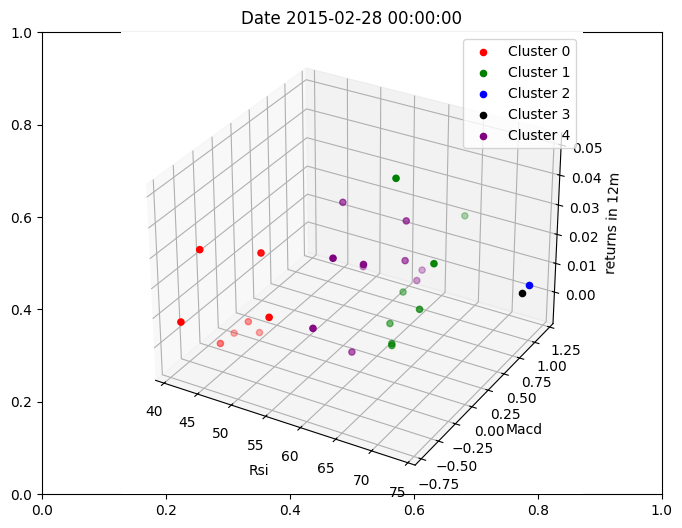

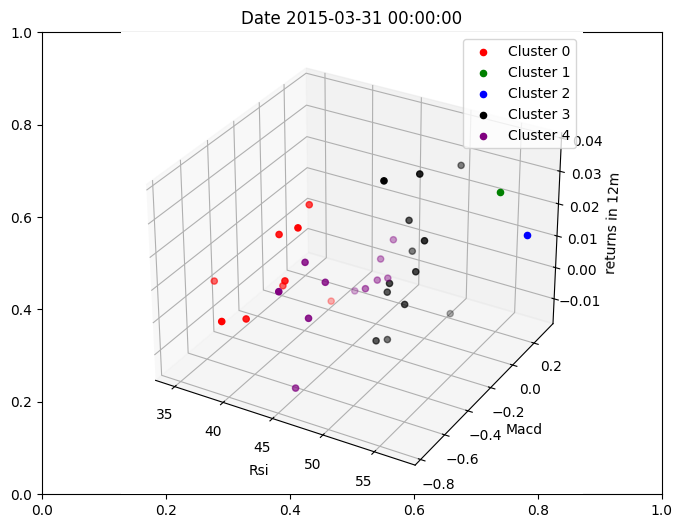

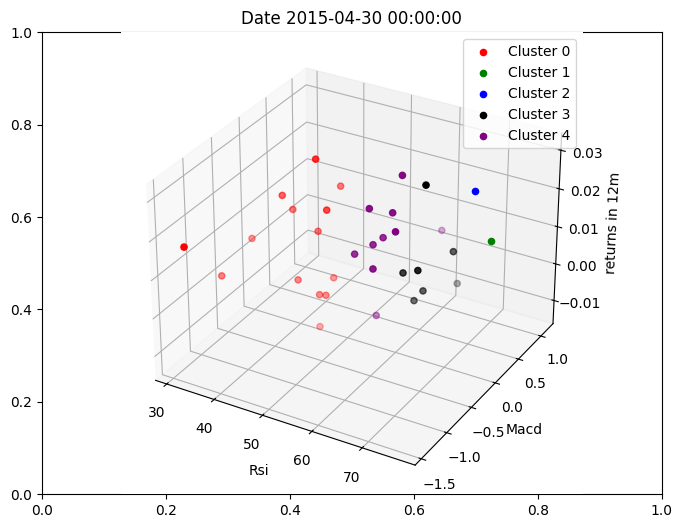

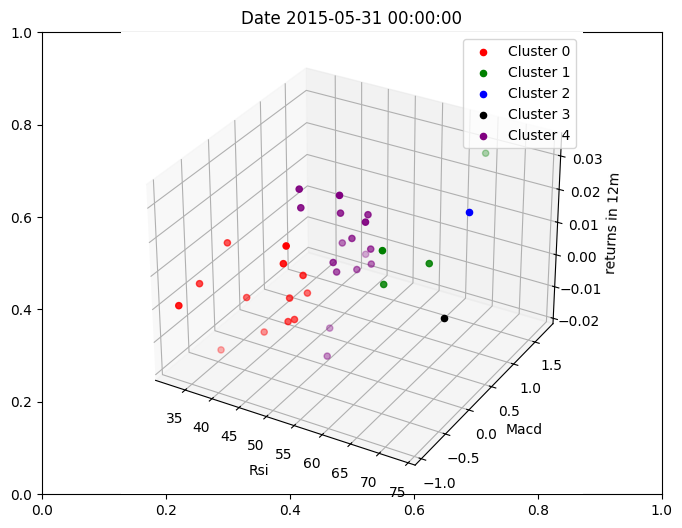

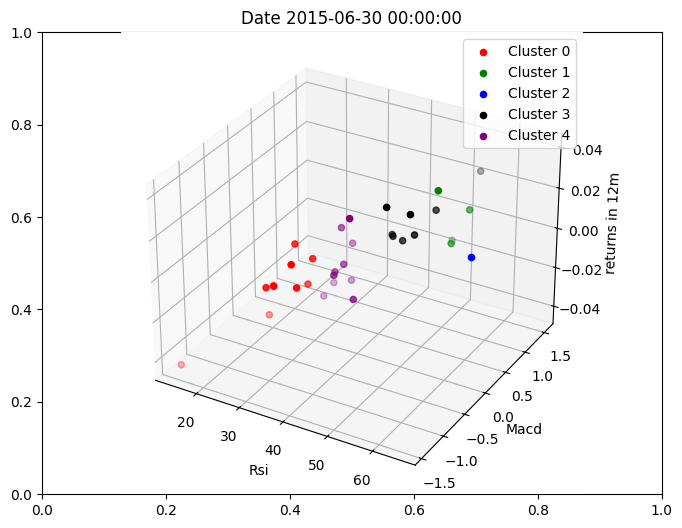

...

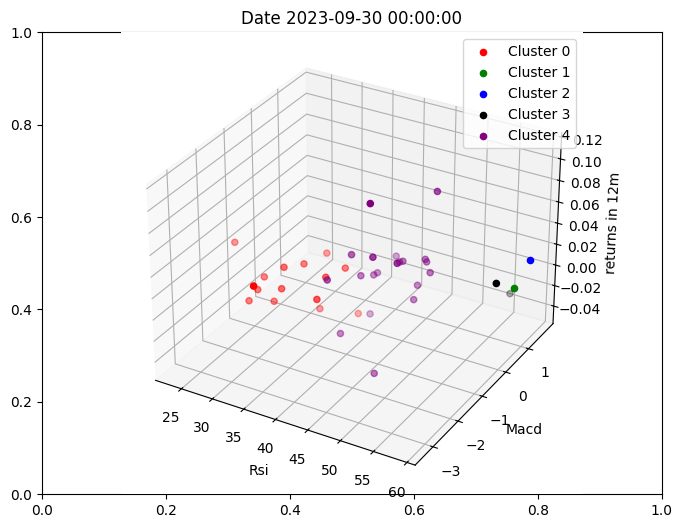

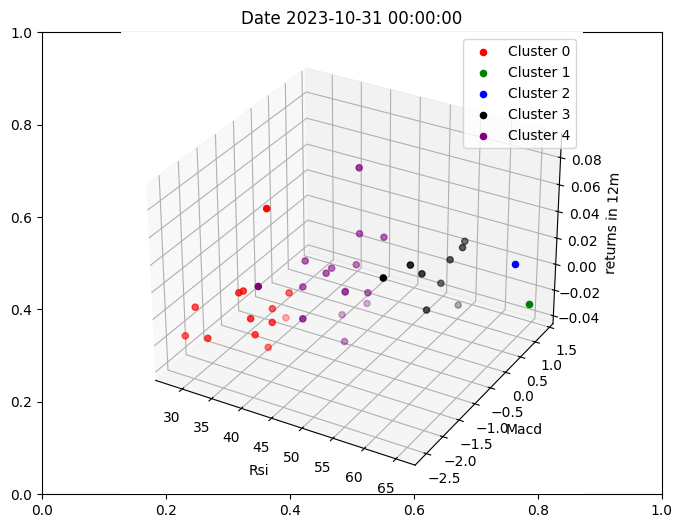

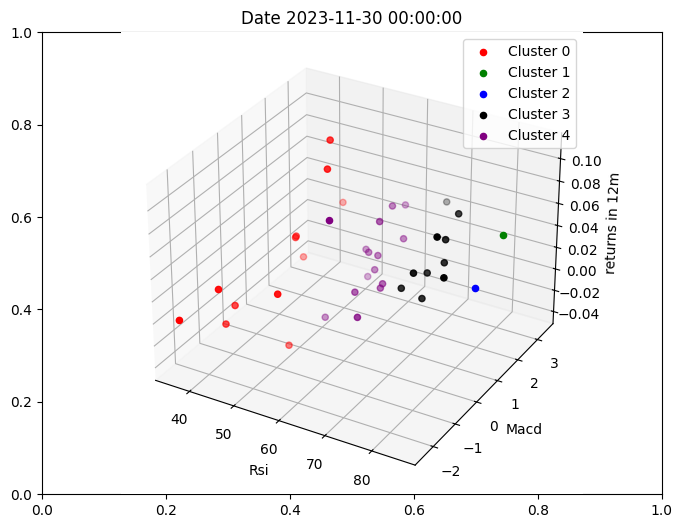

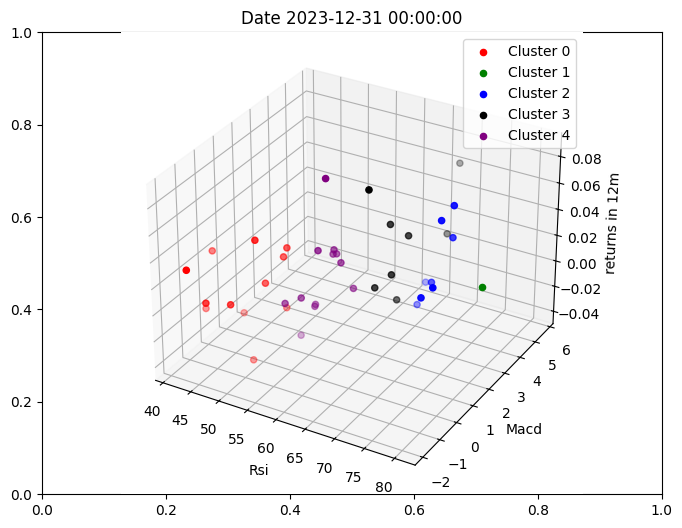

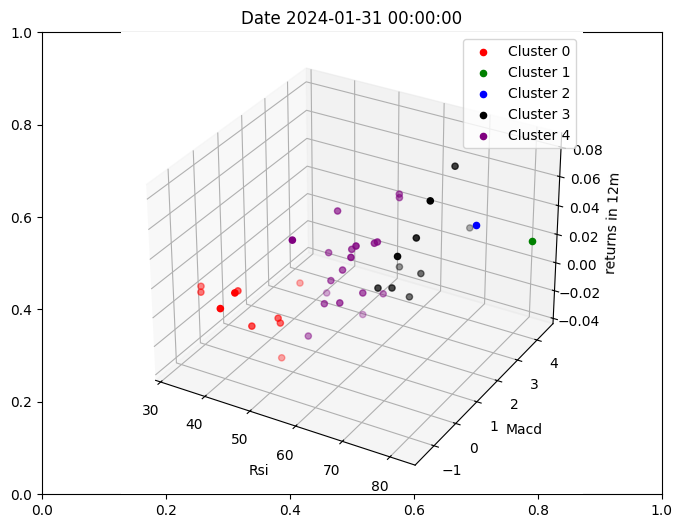

In [12]:
def plot_clusters_3d(data, date):
    fig = plt.figure(figsize=(8, 6))
    plt.title(date)
    # Add 3D subplot
    ax = fig.add_subplot(111, projection='3d')  
    
     # Group data by cluster
    clusters = data.groupby('Cluster') #C
     # Colors for 5 clusters
    colors = ['red', 'green', 'blue', 'black', 'purple'] 

    for i, (cluster_id, cluster_data) in enumerate(clusters):
        ax.scatter(cluster_data.iloc[:, 0],  # Rsi column
                    cluster_data.iloc[:, 1],  # Macd column
                    cluster_data.iloc[:, 13],  # 12m returns
                    color=colors[i], label=f'Cluster {cluster_id}')

    ax.set_xlabel('Rsi')
    ax.set_ylabel('Macd')
    ax.set_zlabel('returns in 12m')
    plt.legend()
    plt.show()
    
def plot_clusters_for_each_date(data):
    # plt.style.use('ggplot')

    for i in data.index.get_level_values('date').unique().tolist():
        g = data.xs(i, level=0)
        # plt.title(f'Date {i}')
        plot_clusters_3d(g, f'Date {i}')

# Example usage:
plot_clusters_for_each_date(data_with_clusters)

In [14]:
def extract_tickers_by_date_for_cluster(data, cluster_id=3):
    filtered_cluster_list = data[data['Cluster'] == cluster_id].copy()

    # Adjust index for date-based operations
    filtered_cluster_list = filtered_cluster_list.reset_index(level=1)
    filtered_cluster_list.index = filtered_cluster_list.index + pd.DateOffset(1)  # Increment dates
    filtered_cluster_list = filtered_cluster_list.reset_index().set_index(['date', 'ticker'])  # Set multi-level index
    

    # Create dictionary for efficient date-ticker retrieval
    tickers_by_formatted_date = {}
    for date in filtered_cluster_list.index.get_level_values('date').unique():
        formatted_date = date.strftime('%Y-%m-%d')
        tickers_for_date = filtered_cluster_list.xs(date).index.tolist()
        tickers_by_formatted_date[formatted_date] = tickers_for_date

    return tickers_by_formatted_date

portfolio_buys_per_month = extract_tickers_by_date_for_cluster(data_with_clusters)
portfolio_buys_per_month

{'2015-03-01': ['GE'],
 '2015-04-01': ['AAPL',
  'AMZN',
  'BA',
  'BKNG',
  'CVX',
  'DIS',
  'HD',
  'IBM',
  'JNJ',
  'JPM',
  'ORCL',
  'QCOM',
  'VZ'],
 '2015-05-01': ['AMZN', 'BKNG', 'CVX', 'IBM', 'MRK', 'TSLA', 'VZ'],
 '2015-06-01': ['TSLA'],
 '2015-07-01': ['AMZN', 'BAC', 'BIIB', 'C', 'GILD', 'HD', 'JPM', 'WFC'],
 '2015-08-01': ['DIS', 'NFLX', 'PFE', 'V'],
 '2015-09-01': ['AMZN'],
 '2015-10-01': ['CSCO', 'CVX', 'GE', 'HD', 'MCD', 'MSFT', 'NFLX', 'PG', 'XOM'],
 '2015-11-01': ['BA', 'DIS', 'GOOG', 'GOOGL', 'JNJ', 'MSFT'],
 '2015-12-01': ['AMZN', 'GOOG', 'GOOGL', 'NFLX'],
 '2016-01-01': ['BA',
  'BRK-B',
  'CSCO',
  'CVX',
  'IBM',
  'INTC',
  'JNJ',
  'JPM',
  'KO',
  'META',
  'MRK',
  'PFE',
  'QCOM',
  'V',
  'WFC',
  'XOM'],
 '2016-02-01': ['JNJ', 'META', 'WMT'],
 '2016-03-01': ['CSCO', 'T', 'TSLA', 'VZ'],
 '2016-04-01': ['AAPL', 'CSCO', 'HD', 'MCD', 'ORCL', 'VZ'],
 '2016-05-01': ['BAC', 'BIIB', 'BKNG', 'GS', 'HD', 'MCD', 'T', 'WFC'],
 '2016-06-01': ['AAPL',
  'BAC',
  'C',
 

In [319]:
def get_this_years_choices(stocks):
    return dict(list(stocks.items())[-14:])
buys_in_2023 = get_this_years_choices(portfolio_buys_per_month)
buys_in_2023

{'2023-01-01': ['ADBE',
  'C',
  'CMCSA',
  'CSCO',
  'HD',
  'JNJ',
  'MSFT',
  'NFLX',
  'UNH',
  'V'],
 '2023-02-01': ['AAPL',
  'ADBE',
  'AMZN',
  'BA',
  'CMCSA',
  'COST',
  'NFLX',
  'NKE',
  'NVDA',
  'QCOM',
  'TSLA',
  'VZ'],
 '2023-03-01': ['AMZN',
  'BA',
  'BAC',
  'BRK-B',
  'COST',
  'CVX',
  'DIS',
  'GOOG',
  'GOOGL',
  'GS',
  'HD',
  'KO',
  'MA',
  'MRK',
  'MSFT',
  'NFLX',
  'PG',
  'PYPL',
  'QCOM',
  'UNH',
  'V',
  'WMT',
  'XOM'],
 '2023-04-01': ['AAPL', 'CSCO', 'INTC', 'META', 'MSFT', 'NVDA', 'PG', 'WMT'],
 '2023-05-01': ['AAPL', 'BRK-B', 'MA', 'MSFT'],
 '2023-06-01': ['AAPL',
  'ADBE',
  'AMD',
  'AMZN',
  'CRM',
  'GOOG',
  'GOOGL',
  'MSFT',
  'NFLX',
  'NVDA',
  'TSLA'],
 '2023-07-01': ['ADBE', 'AVGO', 'COST', 'NFLX', 'TSLA'],
 '2023-08-01': ['AAPL',
  'ABBV',
  'BAC',
  'BRK-B',
  'COST',
  'GOOG',
  'GOOGL',
  'GS',
  'PG',
  'PYPL'],
 '2023-09-01': ['CSCO'],
 '2023-10-01': ['COST', 'UNH'],
 '2023-11-01': ['AMZN',
  'INTC',
  'KO',
  'MCD',
  'MSFT',
 

In [320]:
# chenge dates slightly to ease look up delete this before printing
buys_in_2023 = {'2023-01-03': buys_in_2023['2023-01-01'], '2023-02-01': buys_in_2023['2023-02-01'],
               '2023-03-01': buys_in_2023['2023-03-01'], '2023-04-03': buys_in_2023['2023-04-01'],
               '2023-05-01': buys_in_2023['2023-05-01'], '2023-06-01': buys_in_2023['2023-06-01'],
               '2023-07-03': buys_in_2023['2023-07-01'], '2023-08-01': buys_in_2023['2023-08-01'],
               '2023-09-01': buys_in_2023['2023-09-01'], '2023-10-02': buys_in_2023['2023-02-01'],
               '2023-11-01': buys_in_2023['2023-11-01'], '2023-12-01': buys_in_2023['2023-12-01']}
buys_in_2023

{'2023-01-03': ['ADBE',
  'C',
  'CMCSA',
  'CSCO',
  'HD',
  'JNJ',
  'MSFT',
  'NFLX',
  'UNH',
  'V'],
 '2023-02-01': ['AAPL',
  'ADBE',
  'AMZN',
  'BA',
  'CMCSA',
  'COST',
  'NFLX',
  'NKE',
  'NVDA',
  'QCOM',
  'TSLA',
  'VZ'],
 '2023-03-01': ['AMZN',
  'BA',
  'BAC',
  'BRK-B',
  'COST',
  'CVX',
  'DIS',
  'GOOG',
  'GOOGL',
  'GS',
  'HD',
  'KO',
  'MA',
  'MRK',
  'MSFT',
  'NFLX',
  'PG',
  'PYPL',
  'QCOM',
  'UNH',
  'V',
  'WMT',
  'XOM'],
 '2023-04-03': ['AAPL', 'CSCO', 'INTC', 'META', 'MSFT', 'NVDA', 'PG', 'WMT'],
 '2023-05-01': ['AAPL', 'BRK-B', 'MA', 'MSFT'],
 '2023-06-01': ['AAPL',
  'ADBE',
  'AMD',
  'AMZN',
  'CRM',
  'GOOG',
  'GOOGL',
  'MSFT',
  'NFLX',
  'NVDA',
  'TSLA'],
 '2023-07-03': ['ADBE', 'AVGO', 'COST', 'NFLX', 'TSLA'],
 '2023-08-01': ['AAPL',
  'ABBV',
  'BAC',
  'BRK-B',
  'COST',
  'GOOG',
  'GOOGL',
  'GS',
  'PG',
  'PYPL'],
 '2023-09-01': ['CSCO'],
 '2023-10-02': ['AAPL',
  'ADBE',
  'AMZN',
  'BA',
  'CMCSA',
  'COST',
  'NFLX',
  'NKE',
  

In [164]:

def get_portfolio_tickers(buys):
    stocks = set()
    for [date, stockList] in buys.items():
        for stock in stockList:
            stocks.add(stock)
    return stocks
portfolio_stock_tickers = get_portfolio_tickers(buys_in_2023)
portfolio_stock_tickers = list(portfolio_stock_tickers)
portfolio_stock_tickers

['INTC',
 'COST',
 'PG',
 'PYPL',
 'AVGO',
 'JPM',
 'GOOGL',
 'NVDA',
 'V',
 'NKE',
 'MRK',
 'VZ',
 'AMD',
 'CVX',
 'ABBV',
 'META',
 'WMT',
 'BAC',
 'MA',
 'NFLX',
 'CMCSA',
 'HD',
 'TSLA',
 'QCOM',
 'CRM',
 'DIS',
 'ADBE',
 'KO',
 'XOM',
 'GS',
 'MCD',
 'JNJ',
 'AAPL',
 'CSCO',
 'BRK-B',
 'GOOG',
 'MSFT',
 'UNH',
 'BA',
 'C',
 'AMZN']

In [168]:
portfolio_stock_buys_list_info = df.copy()
portfolio_stock_buys_list_info = portfolio_stock_buys_list_info.reset_index()
portfolio_stock_buys_list_info = portfolio_stock_buys_list_info.set_index('ticker')
portfolio_stock_buys_list_info = portfolio_stock_buys_list_info[portfolio_stock_buys_list_info.index.isin(portfolio_stock_tickers)]

portfolio_stock_buys_list_info

,date,Adj Close,Close,High,Low,Open,Volume,Rsi,Macd,Atr,Dollar_value_traded_mill
ticker,,,,,,,,,,,
AAPL,2014-01-21,17.191612,19.609644,19.645357,19.300714,19.321072,328526800.0,NaN,NaN,NaN,5647.905357
ABBV,2014-01-21,33.140087,50.000000,50.919998,49.910000,50.259998,5823000.0,NaN,NaN,NaN,192.974727
ADBE,2014-01-21,60.849998,60.849998,61.790001,60.700001,61.500000,3198700.0,NaN,NaN,NaN,194.640890
AMD,2014-01-21,4.170000,4.170000,4.340000,4.130000,4.310000,58702900.0,NaN,NaN,NaN,244.791097
AMZN,2014-01-21,20.352501,20.352501,20.389999,20.080000,20.150000,62442000.0,NaN,NaN,NaN,1270.850862
...,...,...,...,...,...,...,...,...,...,...,...
UNH,2024-01-12,521.510010,521.510010,528.479980,513.130005,518.859985,6325800.0,40.197829,-0.414057,0.897228,3298.968020
V,2024-01-12,264.170013,264.170013,265.549988,263.709991,265.130005,4656100.0,66.809423,0.996618,-0.093538,1230.002000
VZ,2024-01-12,38.560001,38.560001,38.770000,38.169998,38.189999,18773500.0,58.839663,1.343768,-0.244801,723.906186


In [169]:
portfolio_stock_buys_list_info = portfolio_stock_buys_list_info.reset_index()
portfolio_stock_buys_list_info = portfolio_stock_buys_list_info.set_index(['date','ticker'])
portfolio_stock_buys_list_info[-11450:]

Adj Close       Close        High         Low        Open  \
date       ticker                                                               
2022-12-01 NKE     109.356461  111.110001  111.860001  109.550003  110.089996   
           NVDA    171.274002  171.350006  172.649994  166.350006  169.990005   
           PG      145.554886  149.250000  150.360001  148.570007  149.529999   
           PYPL     78.529999   78.529999   80.746002   78.139999   79.110001   
           QCOM    123.505280  126.809998  128.199997  125.680000  126.720001   
...                       ...         ...         ...         ...         ...   
2024-01-12 UNH     521.510010  521.510010  528.479980  513.130005  518.859985   
           V       264.170013  264.170013  265.549988  263.709991  265.130005   
           VZ       38.560001   38.560001   38.770000   38.169998   38.189999   
           WMT     161.320007  161.320007  161.539993  160.380005  161.369995   
           XOM      99.949997   99.949997  100.650002   99.169998  100.139999   

                       Volume        Rsi      Macd       Atr  \
date       ticker                                              
2022-12-01 NKE      7822900.0  67.924349  1.921529  0.993692   
           NVDA    47097700.0  65.602893  1.200894  0.679756   
           PG       6927400.0  75.582734  3.035642  0.746682   
           PYPL    15189000.0  41.471646 -0.474618  0.146491   
           QCOM     7924800.0  58.441066  0.809789  1.273056   
...                       ...        ...       ...       ...   
2024-01-12 UNH      6325800.0  40.197829 -0.414057  0.897228   
           V        4656100.0  66.809423  0.996618 -0.093538   
           VZ      18773500.0  58.839663  1.343768 -0.244801   
           WMT      4542600.0  61.893200  0.711942  0.122688   
           XOM     18032100.0  44.746101 -0.712297  0.377890   

                   Dollar_value_traded_mill  
date       ticker                            
2022-12-01 NKE                   855.484655  
           NVDA                 8066.611568  
           PG                   1008.316916  
           PYPL                 1192.792151  
           QCOM                  978.754639  
...                                     ...  
2024-01-12 UNH                  3298.968020  
           V                    1230.002000  
           VZ                    723.906186  
           WMT                   732.812265  
           XOM                  1802.308340  

[11450 rows x 10 columns]

In [170]:
'''
portfolio_stock_buys_list_info = portfolio_stock_buys_list_info.reset_index()
#portfolio_stock_buys_list_info = portfolio_stock_buys_list_info.sort_values(by='Rsi', ascending=False)
#portfolio_stock_buys_list_info = portfolio_stock_buys_list_info.set_index('date')
portfolio_stock_buys_list_info

data_for_date = portfolio_stock_buys_list_info.loc['2023-01-03']
data_for_date
'''

,Adj Close,Close,High,Low,Open,Volume,Rsi,Macd,Atr,Dollar_value_traded_mill
ticker,,,,,,,,,,
AAPL,124.374802,125.070000,130.899994,124.169998,130.279999,112117500.0,32.991106,-2.861590,1.731937,13944.591822
ABBV,154.597794,162.380005,163.020004,160.809998,162.039993,4937500.0,56.211446,0.680254,0.631695,763.326606
ADBE,336.920013,336.920013,345.820007,331.920013,340.160004,2229100.0,52.454737,0.067803,0.618284,751.028402
AMD,64.019997,64.019997,66.879997,63.590000,66.000000,46851800.0,42.590553,-0.967854,0.471150,2999.452079
AMZN,85.820000,85.820000,86.959999,84.209999,85.459999,76706000.0,42.979484,-1.579297,0.466366,6582.908897
AVGO,541.163330,553.479980,567.570007,550.789978,565.000000,2017300.0,56.948278,0.911459,0.853106,1091.688786
BA,195.389999,195.389999,197.179993,192.399994,192.949997,8624600.0,65.957014,0.775938,-0.060138,1685.160589
BAC,32.498127,33.509998,34.090000,33.209999,33.230000,35221500.0,49.273147,-1.032658,0.234806,1144.632780
BRK-B,309.910004,309.910004,312.390015,307.380005,310.070007,3549900.0,55.369198,0.032698,1.442495,1100.149522


In [465]:
# check for rsi above 45 and below 70
def check_for_rsi_per_stock(df, buys):
    vals = []
    for [date, stocklist] in buys.items():
        data_for_date = df.loc[date]
        rsi_vals = []
        for ticker in stocklist:
            #if(data_for_date.loc[ticker]['Rsi'] > 45 and data_for_date.loc[ticker]['Rsi'] < 70):
            rsi_vals.append([ticker, data_for_date.loc[ticker]['Rsi']])
        rsi_vals = sorted(rsi_vals, key=lambda x: x[1])
        month = [date, rsi_vals]
        vals.append(month)
    return vals

rsi_values_per_month = check_for_rsi_per_stock(portfolio_stock_buys_list_info, buys_in_2023)
rsi_values_per_month

[['2023-01-03',
  [['UNH', 41.971482759498656],
   ['MSFT', 46.77383967082459],
   ['HD', 49.177522239295065],
   ['V', 50.1226265728696],
   ['NFLX', 50.699580005879824],
   ['C', 52.33886728837781],
   ['ADBE', 52.45473694989356],
   ['CSCO', 53.41137123613272],
   ['JNJ', 56.65391352089761],
   ['CMCSA', 58.37610699548923]]],
 ['2023-02-01',
  [['AAPL', 63.119577973109976],
   ['VZ', 64.47659504097352],
   ['CMCSA', 64.84508260326432],
   ['NFLX', 66.28184704017434],
   ['BA', 66.31768901301247],
   ['NKE', 66.62794027077585],
   ['TSLA', 67.97402939194684],
   ['AMZN', 68.37209603075593],
   ['COST', 68.96553743748665],
   ['ADBE', 69.55793523550818],
   ['NVDA', 69.94698681478259],
   ['QCOM', 70.23036213927082]]],
 ['2023-03-01',
  [['HD', 32.87493427733093],
   ['NFLX', 35.78787705823822],
   ['DIS', 36.423450672889246],
   ['MA', 36.64833011117065],
   ['GS', 37.35650009006358],
   ['KO', 37.39044425797225],
   ['COST', 37.924320294884886],
   ['PG', 38.4428236477513],
   ['BAC

In [466]:
# check for rsi above 45 and below 70
def check_for_atr_per_stock(df, buys):
    vals = []
    for [date, stocklist] in buys.items():
        data_for_date = df.loc[date]
        atr_vals = []
        for ticker in stocklist:
            #if(data_for_date.loc[ticker]['Rsi'] > 45 and data_for_date.loc[ticker]['Rsi'] < 70):
            atr_vals.append([ticker, data_for_date.loc[ticker]['Atr']])
        atr_vals = sorted(atr_vals, key=lambda x: x[1])
        month = [date, atr_vals]
        vals.append(month)
    return vals

atr_values_per_month = check_for_atr_per_stock(portfolio_stock_buys_list_info, buys_in_2023)
atr_values_per_month

[['2023-01-03',
  [['C', -0.5105987834585115],
   ['CMCSA', 0.06793872085976813],
   ['JNJ', 0.15800400607226425],
   ['CSCO', 0.20039266808359898],
   ['NFLX', 0.5151403089039507],
   ['ADBE', 0.6182839973376413],
   ['V', 0.6473233991253434],
   ['UNH', 1.1623045577886748],
   ['MSFT', 1.2006040670902405],
   ['HD', 1.3257756286426885]]],
 ['2023-02-01',
  [['BA', -0.03276478325160198],
   ['CMCSA', 0.31997321406938994],
   ['VZ', 0.39319574006526326],
   ['NFLX', 0.41006950266324554],
   ['ADBE', 0.5488792290947931],
   ['AMZN', 0.7034190355037483],
   ['NKE', 0.8418173215791652],
   ['QCOM', 1.0445833987244453],
   ['NVDA', 1.0483945397115777],
   ['TSLA', 1.0543637992385388],
   ['COST', 1.2433726565726149],
   ['AAPL', 1.248426849772009]]],
 ['2023-03-01',
  [['PYPL', -0.3415403209789528],
   ['BA', -0.1296938972811363],
   ['BAC', -0.056077214618091224],
   ['DIS', 0.1463915442829462],
   ['V', 0.3152263741398093],
   ['MA', 0.35871130099013837],
   ['KO', 0.37938471083517694],


In [212]:
#get individual info on a stock
def get_individual(df, stock):
    df_copy = df.copy()
    df_individual = df_copy.loc[(df_copy.index.get_level_values('ticker') == stock)]
    return df_individual
'''aapl_stock_temp = get_individual(portfolio_stock_buys_list_info, 'JNJ').reset_index().drop('ticker', axis=1).set_index('date').dropna()
aapl_stock_temp[-260:]'''

,Adj Close,Close,High,Low,Open,Volume,Rsi,Macd,Atr,Dollar_value_traded_mill
date,,,,,,,,,,
2022-12-30,171.447403,176.649994,177.770004,175.399994,177.490005,4216600.0,51.916893,0.314416,0.142541,722.925119
2023-01-03,172.942062,178.190002,178.380005,176.009995,176.160004,6344900.0,56.653914,0.344250,0.158004,1097.300092
2023-01-04,174.824936,180.130005,180.190002,178.479996,178.889999,9788800.0,61.741200,0.474136,0.141268,1711.326333
2023-01-05,173.534088,178.800003,179.990005,178.410004,179.020004,6255300.0,56.840986,0.491230,0.102196,1085.507782
2023-01-06,174.941391,180.250000,180.929993,179.389999,180.130005,5706000.0,60.502690,0.581034,0.100370,998.215577
...,...,...,...,...,...,...,...,...,...,...
2024-01-08,161.529999,161.529999,161.660004,159.610001,161.100006,6569800.0,68.500561,1.273238,-0.032064,1061.219786
2024-01-09,161.630005,161.630005,163.279999,160.600006,161.630005,6357000.0,68.730100,1.339671,0.021922,1027.481941
2024-01-10,161.869995,161.869995,162.619995,161.199997,161.820007,4945100.0,69.305209,1.388689,-0.033837,800.463313


Use Time Series Analysis to check a predicted value on stocks

In [221]:
df

Adj Close       Close        High         Low        Open  \
date       ticker                                                               
2014-01-21 A        39.982552   43.526466   43.547928   42.818314   43.412018   
           AAL      28.904451   30.660000   30.799999   30.200001   30.660000   
           AAPL     17.191612   19.609644   19.645357   19.300714   19.321072   
           ABBV     33.140087   50.000000   50.919998   49.910000   50.259998   
           ABT      32.279087   39.119999   39.570000   38.860001   39.520000   
...                       ...         ...         ...         ...         ...   
2024-01-12 YUM     129.130005  129.130005  129.479996  128.320007  129.479996   
           ZBH     123.070000  123.070000  124.750000  122.349998  123.690002   
           ZBRA    248.869995  248.869995  259.170013  243.559998  256.769989   
           ZION     42.110001   42.110001   43.660000   41.799999   43.580002   
           ZTS     198.940002  198.940002  199.559998  196.869995  197.679993   

                        Volume        Rsi      Macd       Atr  \
date       ticker                                               
2014-01-21 A         4205883.0        NaN       NaN       NaN   
           AAL      10612500.0        NaN       NaN       NaN   
           AAPL    328526800.0        NaN       NaN       NaN   
           ABBV      5823000.0        NaN       NaN       NaN   
           ABT       8229600.0        NaN       NaN       NaN   
...                        ...        ...       ...       ...   
2024-01-12 YUM       1080800.0  53.640902  0.168474  0.075531   
           ZBH       1735800.0  68.594051  0.821875 -0.615684   
           ZBRA       625600.0  46.284606  0.347451  0.312750   
           ZION      1713500.0  51.313284  1.171177  0.503484   
           ZTS       1726500.0  64.369105  1.451610  0.663847   

                   Dollar_value_traded_mill  
date       ticker                            
2014-01-21 A                     168.161934  
           AAL                   306.748490  
           AAPL                 5647.905357  
           ABBV                  192.974727  
           ABT                   265.643975  
...                                     ...  
2024-01-12 YUM                   139.563709  
           ZBH                   213.624905  
           ZBRA                  155.693069  
           ZION                   72.155486  
           ZTS                   343.469914  

[1233640 rows x 10 columns]

In [247]:
def getAvgCol(df, STOCK):
    df_individual = get_individual(df, STOCK)
    df_individual['Average'] = (df_individual['High'] + df_individual['Low'])/2
    df_individual['Date'] = df_individual.index
    return df_individual.reset_index().drop('ticker', axis=1).set_index('date').dropna()

df_individual_stock = getAvgCol(df, 'AAPL')

df_individual_stock = df_individual_stock
# pick Scaler (MinMaxScaler, StandardScaler, RobustScaler, MaxAbsScaler)
scaler = MinMaxScaler()
# change the transformed column from CLose to Average to check on the middle ground between daily lows and highs
df_individual_stock['Scaled'] = scaler.fit_transform(np.expand_dims(df_individual_stock['Rsi'].values, axis=1))

N_days = 30
STEPS = [1,10,15,30,45]

df_individual_stock

,Adj Close,Close,High,Low,Open,Volume,Rsi,Macd,Atr,Dollar_value_traded_mill,Average,Date,Scaled
date,,,,,,,,,,,,,
2014-02-26,16.295404,18.476786,18.750000,18.414286,18.700357,276217200.0,40.218501,-0.234776,-0.974395,4501.070986,18.582143,"(2014-02-26 00:00:00, AAPL)",0.264105
2014-02-27,16.620462,18.845358,18.885000,18.430357,18.469286,301882000.0,48.557670,-0.237781,-0.968417,5017.418436,18.657679,"(2014-02-27 00:00:00, AAPL)",0.387093
2014-02-28,16.575417,18.794287,19.026787,18.647142,18.895714,371968800.0,47.572371,-0.242491,-0.967079,6165.537809,18.836965,"(2014-02-28 00:00:00, AAPL)",0.372562
2014-03-03,16.623299,18.848572,18.951786,18.671785,18.693571,238781200.0,48.756584,-0.244378,-0.971219,3969.331198,18.811786,"(2014-03-03 00:00:00, AAPL)",0.390027
2014-03-04,16.732908,18.972857,19.022858,18.848928,18.964287,259140000.0,51.446442,-0.241308,-0.980603,4336.165844,18.935893,"(2014-03-04 00:00:00, AAPL)",0.429698
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-08,185.559998,185.559998,185.600006,181.500000,182.089996,59144500.0,42.060201,-1.085653,0.818201,10974.853276,183.550003,"(2024-01-08 00:00:00, AAPL)",0.291267
2024-01-09,185.139999,185.139999,185.149994,182.729996,183.919998,42841800.0,41.354902,-1.155737,0.806858,7931.730826,183.939995,"(2024-01-09 00:00:00, AAPL)",0.280865
2024-01-10,186.190002,186.190002,186.399994,183.919998,184.350006,46792900.0,43.875818,-1.154192,0.779883,8712.370165,185.159996,"(2024-01-10 00:00:00, AAPL)",0.318044


In [242]:
def prepare_data_for_prediction(initial_data, prediction_window_size):
    # Avoid modifying the original DataFrame
    data = initial_data.copy()  
    data["Future_scaled"] = data["Scaled"].shift(-prediction_window_size)

    #initial_sequences = data["Scaled"].tail(prediction_window_size).to_numpy()
    lst_seq = np.array(data[['Scaled']].tail(prediction_window_size))
    # print(len(data))
    data.dropna(inplace=True)
    # print(len(data))
    sequences = deque(maxlen=N_days)
    input_sequences, target_values = [], []
    sequence_data = []
    
    for scaled_entries, future_value in zip( data[["Scaled"] + ["Date"]].values, data["Future_scaled"].values):
        # Store both scaled_close and date
        sequences.append(scaled_entries)  

        if len(sequences) == N_days:
            # Extract only Scaled
            sequence_data.append([np.array(sequences), future_value])
    
    lst_seq = list([s[:len(['Scaled'])] for s in sequences]) + list(lst_seq)
    lst_seq = np.array(lst_seq).astype(np.float32)
    
    # print(sequence_data)
        
    for seqs, future_value in sequence_data:
            input_sequences.append(seqs)  
            target_values.append(future_value)
            
    input_sequences = np.array(input_sequences)
    target_values = np.array(target_values)
    
    

    return (
        data,
        lst_seq,
        input_sequences,
        target_values,
    )

In [243]:
def build_and_train_time_series_model(input_sequences, target_values):
    
    model = Sequential()
    model.add(LSTM(85, return_sequences=True, input_shape=(N_days, len(['Scaled']))))
    model.add(Dropout(0.2))
    model.add(LSTM(130, return_sequences=False))
    model.add(Dropout(0.35))
    model.add(Dense(35))
    model.add(Dense(20))
    model.add(Dense(1))

    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(input_sequences, target_values, batch_size=8, epochs=120, verbose=2)
    model.summary()

    return model

In [260]:
def train_and_get_predictions(N_days, STEPS, df_individual_stock):
    all_predictions_rsi = []
    
    df_individual_stock['Scaled'] = scaler.fit_transform(np.expand_dims(df_individual_stock['Rsi'].values, axis=1))
    # Iterate through prediction steps
    for prediction_horizon in STEPS:
        data, lst_seq, input_sequences, target_values, = prepare_data_for_prediction(df_individual_stock, prediction_horizon)
        # print(lst_seq)
        input_sequences = input_sequences[:,:, :len(['Scaled'])].astype(np.float32)

        model = build_and_train_time_series_model( input_sequences, target_values )

        recent_data = lst_seq[-N_days:]
        prediction_input = np.expand_dims(recent_data, axis=0)

        predicted_value = model.predict(prediction_input)
        predicted_price = scaler.inverse_transform(predicted_value)[0][0]

        all_predictions_rsi.append(round(float(predicted_price), 2))

    return all_predictions_rsi

In [245]:
if len(all_predictions_rsi) > 0:
    print(all_predictions_rsi)

[45.43, 48.95, 42.48, 43.65, 44.02, 60.41]


In [259]:
df

Adj Close       Close        High         Low        Open  \
date       ticker                                                               
2014-01-21 A        39.982552   43.526466   43.547928   42.818314   43.412018   
           AAL      28.904451   30.660000   30.799999   30.200001   30.660000   
           AAPL     17.191612   19.609644   19.645357   19.300714   19.321072   
           ABBV     33.140087   50.000000   50.919998   49.910000   50.259998   
           ABT      32.279087   39.119999   39.570000   38.860001   39.520000   
...                       ...         ...         ...         ...         ...   
2024-01-12 YUM     129.130005  129.130005  129.479996  128.320007  129.479996   
           ZBH     123.070000  123.070000  124.750000  122.349998  123.690002   
           ZBRA    248.869995  248.869995  259.170013  243.559998  256.769989   
           ZION     42.110001   42.110001   43.660000   41.799999   43.580002   
           ZTS     198.940002  198.940002  199.559998  196.869995  197.679993   

                        Volume        Rsi      Macd       Atr  \
date       ticker                                               
2014-01-21 A         4205883.0        NaN       NaN       NaN   
           AAL      10612500.0        NaN       NaN       NaN   
           AAPL    328526800.0        NaN       NaN       NaN   
           ABBV      5823000.0        NaN       NaN       NaN   
           ABT       8229600.0        NaN       NaN       NaN   
...                        ...        ...       ...       ...   
2024-01-12 YUM       1080800.0  53.640902  0.168474  0.075531   
           ZBH       1735800.0  68.594051  0.821875 -0.615684   
           ZBRA       625600.0  46.284606  0.347451  0.312750   
           ZION      1713500.0  51.313284  1.171177  0.503484   
           ZTS       1726500.0  64.369105  1.451610  0.663847   

                   Dollar_value_traded_mill  
date       ticker                            
2014-01-21 A                     168.161934  
           AAL                   306.748490  
           AAPL                 5647.905357  
           ABBV                  192.974727  
           ABT                   265.643975  
...                                     ...  
2024-01-12 YUM                   139.563709  
           ZBH                   213.624905  
           ZBRA                  155.693069  
           ZION                   72.155486  
           ZTS                   343.469914  

[1233640 rows x 10 columns]

In [252]:
df

Adj Close       Close        High         Low        Open  \
date       ticker                                                               
2014-01-21 A        39.982552   43.526466   43.547928   42.818314   43.412018   
           AAL      28.904451   30.660000   30.799999   30.200001   30.660000   
           AAPL     17.191612   19.609644   19.645357   19.300714   19.321072   
           ABBV     33.140087   50.000000   50.919998   49.910000   50.259998   
           ABT      32.279087   39.119999   39.570000   38.860001   39.520000   
...                       ...         ...         ...         ...         ...   
2024-01-12 YUM     129.130005  129.130005  129.479996  128.320007  129.479996   
           ZBH     123.070000  123.070000  124.750000  122.349998  123.690002   
           ZBRA    248.869995  248.869995  259.170013  243.559998  256.769989   
           ZION     42.110001   42.110001   43.660000   41.799999   43.580002   
           ZTS     198.940002  198.940002  199.559998  196.869995  197.679993   

                        Volume        Rsi      Macd       Atr  \
date       ticker                                               
2014-01-21 A         4205883.0        NaN       NaN       NaN   
           AAL      10612500.0        NaN       NaN       NaN   
           AAPL    328526800.0        NaN       NaN       NaN   
           ABBV      5823000.0        NaN       NaN       NaN   
           ABT       8229600.0        NaN       NaN       NaN   
...                        ...        ...       ...       ...   
2024-01-12 YUM       1080800.0  53.640902  0.168474  0.075531   
           ZBH       1735800.0  68.594051  0.821875 -0.615684   
           ZBRA       625600.0  46.284606  0.347451  0.312750   
           ZION      1713500.0  51.313284  1.171177  0.503484   
           ZTS       1726500.0  64.369105  1.451610  0.663847   

                   Dollar_value_traded_mill  
date       ticker                            
2014-01-21 A                     168.161934  
           AAL                   306.748490  
           AAPL                 5647.905357  
           ABBV                  192.974727  
           ABT                   265.643975  
...                                     ...  
2024-01-12 YUM                   139.563709  
           ZBH                   213.624905  
           ZBRA                  155.693069  
           ZION                   72.155486  
           ZTS                   343.469914  

[1233640 rows x 10 columns]

In [277]:
buys_in_2023

buys_in_2023_part1 = {'2023-01-03': buys_in_2023['2023-01-03'], '2023-02-01': buys_in_2023['2023-02-01'],
               '2023-03-01': buys_in_2023['2023-03-01'], '2023-04-03': buys_in_2023['2023-04-03']}
buys_in_2023_part2 = {'2023-05-01': buys_in_2023['2023-05-01'], '2023-06-01': buys_in_2023['2023-06-01'],
               '2023-07-03': buys_in_2023['2023-07-03'], '2023-08-01': buys_in_2023['2023-08-01']}
buys_in_2023_part3 = {'2023-09-01': buys_in_2023['2023-09-01'], '2023-10-02': buys_in_2023['2023-02-01'],
               '2023-11-01': buys_in_2023['2023-11-01'], '2023-12-01': buys_in_2023['2023-12-01']}
buys_in_2023_part1

{'2023-01-03': ['ADBE',
  'C',
  'CMCSA',
  'CSCO',
  'HD',
  'JNJ',
  'MSFT',
  'NFLX',
  'UNH',
  'V'],
 '2023-02-01': ['AAPL',
  'ADBE',
  'AMZN',
  'BA',
  'CMCSA',
  'COST',
  'NFLX',
  'NKE',
  'NVDA',
  'QCOM',
  'TSLA',
  'VZ'],
 '2023-03-01': ['AMZN',
  'BA',
  'BAC',
  'BRK-B',
  'COST',
  'CVX',
  'DIS',
  'GOOG',
  'GOOGL',
  'GS',
  'HD',
  'KO',
  'MA',
  'MRK',
  'MSFT',
  'NFLX',
  'PG',
  'PYPL',
  'QCOM',
  'UNH',
  'V',
  'WMT',
  'XOM'],
 '2023-04-03': ['AAPL', 'CSCO', 'INTC', 'META', 'MSFT', 'NVDA', 'PG', 'WMT']}

In [279]:
scaler = MinMaxScaler()
N_days = 30
STEPS = [1,15,30,45,60]

# perform time series analysis for the rsi value on each stock of the portfolio
# adapted to each months values.
def train_for_every_ticker_per_month(df, buys, N_days, STEPS):
    df_copy = df.copy()
    final_check = []
    for [date, stocklist] in buys.items():
        # adjust dataframe for specific date
        month = []
        date = pd.to_datetime(date)
        filtered_df = df_copy[df_copy.index.map(lambda x: x[0]) < date]
        # print(filtered_df)
        for stock in stocklist:
            print(stock)
            df_individual_stock = getAvgCol(filtered_df, stock)
            pred_rsi = train_and_get_predictions(N_days, STEPS, df_individual_stock)
            # print(pred_rsi)
            mean = np.mean(pred_rsi)
            std = np.std(pred_rsi)
            outlier_indices_1 = [index for index, value in enumerate(pred_rsi) if abs(value - mean) > std]
            outlier_indices_2 = [index for index, value in enumerate(pred_rsi) if abs(value - mean) > 2* std]
            stock_this_month = [stock, pred_rsi, outlier_indices_1, outlier_indices_2]
            month.append(stock_this_month)
        final_check.append([date, month])
    return final_check

#temp_check_complete_model_just_in_case = {'2023-01-03': ['JNJ']}
print('part1')
final_result_check_complete_model_part_1 = train_for_every_ticker_per_month(df, buys_in_2023_part1, N_days, STEPS)
print('part2')
final_result_check_complete_model_part_2 = train_for_every_ticker_per_month(df, buys_in_2023_part2, N_days, STEPS)
print('part3')
final_result_check_complete_model_part_3 = train_for_every_ticker_per_month(df, buys_in_2023_part3, N_days, STEPS)
#final_result_check_complete_model_just_in_case = train_for_every_ticker_per_month(df, temp_check_complete_model_just_in_case, N_days, STEPS)

part1
ADBE
Epoch 1/120
275/275 - 2s - loss: 0.0170 - 2s/epoch - 9ms/step
Epoch 2/120
275/275 - 1s - loss: 0.0107 - 1s/epoch - 5ms/step
Epoch 3/120
275/275 - 1s - loss: 0.0082 - 1s/epoch - 5ms/step
Epoch 4/120
275/275 - 1s - loss: 0.0073 - 1s/epoch - 4ms/step
Epoch 5/120
275/275 - 1s - loss: 0.0065 - 1s/epoch - 5ms/step
Epoch 6/120
275/275 - 1s - loss: 0.0066 - 1s/epoch - 4ms/step
Epoch 7/120
275/275 - 1s - loss: 0.0059 - 1s/epoch - 5ms/step
Epoch 8/120
275/275 - 1s - loss: 0.0057 - 1s/epoch - 5ms/step
Epoch 9/120
275/275 - 1s - loss: 0.0057 - 1s/epoch - 5ms/step
Epoch 10/120
275/275 - 1s - loss: 0.0059 - 1s/epoch - 5ms/step
Epoch 11/120
275/275 - 1s - loss: 0.0057 - 1s/epoch - 5ms/step
Epoch 12/120
275/275 - 1s - loss: 0.0055 - 1s/epoch - 5ms/step
Epoch 13/120
275/275 - 1s - loss: 0.0055 - 1s/epoch - 5ms/step
Epoch 14/120
275/275 - 1s - loss: 0.0055 - 1s/epoch - 5ms/step
Epoch 15/120
275/275 - 1s - loss: 0.0056 - 1s/epoch - 5ms/step
Epoch 16/120
275/275 - 1s - loss: 0.0054 - 1s/epoch -

In [280]:
final_result_check_complete_model_part_1

[[Timestamp('2023-01-03 00:00:00'),
  [['ADBE', [53.05, 62.88, 47.61, 53.82, 55.25], [1, 2], []],
   ['C', [50.18, 59.41, 56.34, 50.45, 43.83], [1, 4], []],
   ['CMCSA', [52.44, 50.84, 63.84, 55.57, 53.08], [2], []],
   ['CSCO', [51.63, 56.01, 46.61, 52.77, 52.46], [1, 2], []],
   ['HD', [49.24, 46.88, 53.3, 67.45, 65.24], [1, 3, 4], []],
   ['JNJ', [52.6, 60.24, 54.43, 42.94, 49.45], [1, 3], []],
   ['MSFT', [47.04, 47.21, 54.75, 52.66, 54.83], [0, 1, 4], []],
   ['NFLX', [50.45, 52.52, 52.58, 62.87, 55.44], [3], []],
   ['UNH', [49.68, 54.62, 55.68, 64.75, 46.31], [3, 4], []],
   ['V', [50.82, 53.79, 51.87, 51.77, 53.75], [0, 1, 4], []]]],
 [Timestamp('2023-02-01 00:00:00'),
  [['AAPL', [62.24, 56.09, 49.09, 55.71, 66.41], [2, 4], []],
   ['ADBE', [64.44, 56.71, 60.62, 53.02, 54.79], [0, 3], []],
   ['AMZN', [66.15, 42.45, 40.19, 57.12, 55.07], [0, 1, 2], []],
   ['BA', [64.78, 70.17, 53.62, 64.32, 59.72], [1, 2], []],
   ['CMCSA', [62.74, 51.98, 55.56, 49.48, 51.21], [0, 3], []],
  

In [281]:
final_result_check_complete_model_part_2

[[Timestamp('2023-05-01 00:00:00'),
  [['AAPL', [67.02, 63.42, 55.2, 56.08, 57.88], [0, 2], []],
   ['BRK-B', [68.26, 62.96, 53.49, 58.8, 46.3], [0, 4], []],
   ['MA', [65.26, 55.61, 52.59, 55.13, 50.25], [0, 4], []],
   ['MSFT', [66.29, 54.5, 48.96, 63.71, 49.98], [0, 2], []]]],
 [Timestamp('2023-06-01 00:00:00'),
  [['AAPL', [64.4, 55.23, 60.95, 57.86, 56.47], [0, 1], []],
   ['ADBE', [71.49, 72.07, 55.93, 43.18, 54.02], [0, 1, 3], []],
   ['AMD', [64.65, 61.5, 55.75, 56.35, 49.23], [0, 4], []],
   ['AMZN', [67.27, 62.03, 47.98, 54.7, 57.26], [0, 2], []],
   ['CRM', [71.59, 59.72, 62.59, 54.35, 51.12], [0, 4], []],
   ['GOOG', [63.58, 49.89, 43.73, 54.14, 54.31], [0, 2], []],
   ['GOOGL', [65.09, 61.25, 59.64, 52.96, 46.81], [0, 4], []],
   ['MSFT', [66.16, 58.71, 55.88, 57.43, 56.3], [0], []],
   ['NFLX', [72.81, 42.62, 51.73, 49.5, 44.21], [0], []],
   ['NVDA', [72.31, 63.0, 70.35, 58.76, 57.38], [0, 4], []],
   ['TSLA', [67.92, 58.1, 40.59, 54.02, 54.18], [0, 2], []]]],
 [Timestam

In [282]:
final_result_check_complete_model_part_3

[[Timestamp('2023-09-01 00:00:00'),
  [['CSCO', [70.07, 55.87, 57.79, 52.76, 52.84], [0], []]]],
 [Timestamp('2023-10-02 00:00:00'),
  [['AAPL', [39.81, 49.56, 63.43, 52.32, 47.14], [0, 2], []],
   ['ADBE', [42.34, 50.21, 45.82, 53.26, 54.98], [0, 4], []],
   ['AMZN', [39.86, 45.34, 47.46, 51.86, 52.69], [0, 4], []],
   ['BA', [25.64, 43.45, 52.09, 44.23, 61.9], [0, 4], []],
   ['CMCSA', [44.4, 60.92, 60.67, 52.35, 51.82], [0, 1, 2], []],
   ['COST', [57.95, 56.01, 47.8, 57.99, 58.13], [2], []],
   ['NFLX', [33.75, 52.63, 47.97, 50.65, 38.49], [0, 1], []],
   ['NKE', [49.65, 43.99, 43.59, 49.15, 52.78], [1, 2, 4], []],
   ['NVDA', [48.43, 69.18, 53.38, 56.24, 61.02], [0, 1], []],
   ['QCOM', [47.94, 36.23, 48.29, 54.23, 52.86], [1], []],
   ['TSLA', [50.81, 48.61, 44.74, 53.94, 48.28], [2, 3], []],
   ['VZ', [37.78, 49.67, 50.91, 51.21, 50.29], [0], []]]],
 [Timestamp('2023-11-01 00:00:00'),
  [['AMZN', [55.65, 32.76, 58.49, 55.09, 56.45], [1], []],
   ['INTC', [56.08, 44.46, 45.43, 51

In [306]:
type(final_result_check_complete_model_part_3)
#df_check_final_result_check_complete_model_part_1 = pd.DataFrame(final_result_check_complete_model_part_1)
# file_path_final_check = 'C:\\Users\\Usuario\\Documents\\DocsMain\\Informatik\\Bachelor\'sThesisMasterFile\\df_check_final_result_check_complete_model.csv'
#df_check_final_result_check_complete_model_part_1.to_csv(file_path_final_check, index = False)

In [371]:
df_check_final_result_check_complete_model_part_1 = pd.DataFrame(final_result_check_complete_model_part_1)
df_check_final_result_check_complete_model_part_2 = pd.DataFrame(final_result_check_complete_model_part_2)
df_check_final_result_check_complete_model_part_3 = pd.DataFrame(final_result_check_complete_model_part_3)
df_check_final_result_check_complete_model_part_1_and_2 = pd.concat([df_check_final_result_check_complete_model_part_1,
                                                                    df_check_final_result_check_complete_model_part_2,
                                                                    df_check_final_result_check_complete_model_part_3])
#df_check_final_result_check_complete_model_part_1_and_2
df_check_final_result_check_complete_model_part_1_and_2.columns = ['date', 'values']
df_check_final_result_check_complete_model_part_1_and_2 = df_check_final_result_check_complete_model_part_1_and_2.set_index('date')
df_check_final_result_check_complete_model_part_1_and_2

,values
date,
2023-01-03,"[[ADBE, [53.05, 62.88, 47.61, 53.82, 55.25], [..."
2023-02-01,"[[AAPL, [62.24, 56.09, 49.09, 55.71, 66.41], [..."
2023-03-01,"[[AMZN, [45.17, 48.37, 60.67, 54.1, 52.93], [0..."
2023-04-03,"[[AAPL, [67.26, 51.78, 54.37, 49.92, 51.71], [..."
2023-05-01,"[[AAPL, [67.02, 63.42, 55.2, 56.08, 57.88], [0..."
2023-06-01,"[[AAPL, [64.4, 55.23, 60.95, 57.86, 56.47], [0..."
2023-07-03,"[[ADBE, [67.61, 66.53, 56.0, 55.03, 53.74], [0..."
2023-08-01,"[[AAPL, [66.84, 59.41, 63.87, 55.64, 57.91], [..."
2023-09-01,"[[CSCO, [70.07, 55.87, 57.79, 52.76, 52.84], [..."


In [397]:
df_final_check_temp = df_check_final_result_check_complete_model_part_1_and_2.copy()
df_final_check_temp = df_final_check_temp.explode('values')
df_final_check_temp

,values
date,
2023-01-03,"[ADBE, [53.05, 62.88, 47.61, 53.82, 55.25], [1..."
2023-01-03,"[C, [50.18, 59.41, 56.34, 50.45, 43.83], [1, 4..."
2023-01-03,"[CMCSA, [52.44, 50.84, 63.84, 55.57, 53.08], [..."
2023-01-03,"[CSCO, [51.63, 56.01, 46.61, 52.77, 52.46], [1..."
2023-01-03,"[HD, [49.24, 46.88, 53.3, 67.45, 65.24], [1, 3..."
...,...
2023-12-01,"[MCD, [71.93, 54.24, 42.35, 54.92, 53.86], [0,..."
2023-12-01,"[MSFT, [65.17, 58.36, 61.12, 57.29, 52.1], [0,..."
2023-12-01,"[NFLX, [70.13, 70.17, 49.23, 55.7, 53.98], [0,..."


In [402]:
# df_final_check_temp['ticker'] = df_final_check_temp['values'].apply(lambda x: x[0])
# df_final_check_temp['rsi_pred'] = df_final_check_temp['values'].apply(lambda x: x[1])
# df_final_check_temp['outliers_1'] = df_final_check_temp['values'].apply(lambda x: x[2])
# df_final_check_temp['outliers_2'] = df_final_check_temp['values'].apply(lambda x: x[3])
df_final_check_temp = df_final_check_temp.drop('values', axis=1)
df_final_check_temp

,ticker,rsi_pred,outliers_1,outliers_2
date,,,,
2023-01-03,ADBE,"[53.05, 62.88, 47.61, 53.82, 55.25]","[1, 2]",[]
2023-01-03,C,"[50.18, 59.41, 56.34, 50.45, 43.83]","[1, 4]",[]
2023-01-03,CMCSA,"[52.44, 50.84, 63.84, 55.57, 53.08]",[2],[]
2023-01-03,CSCO,"[51.63, 56.01, 46.61, 52.77, 52.46]","[1, 2]",[]
2023-01-03,HD,"[49.24, 46.88, 53.3, 67.45, 65.24]","[1, 3, 4]",[]
...,...,...,...,...
2023-12-01,MCD,"[71.93, 54.24, 42.35, 54.92, 53.86]","[0, 2]",[]
2023-12-01,MSFT,"[65.17, 58.36, 61.12, 57.29, 52.1]","[0, 4]",[]
2023-12-01,NFLX,"[70.13, 70.17, 49.23, 55.7, 53.98]","[0, 1, 2]",[]


In [403]:
#new_path_for_new_file = 'C:\\Users\\Usuario\\Documents\\DocsMain\\Informatik\\Bachelor\'sThesisMasterFile\\df_final_portfolio_rsi_and_outliers.csv'

#df_final_check_temp.to_csv(new_path_for_new_file, index=True)

In [352]:
buys_in_2023

{'2023-01-03': ['ADBE',
  'C',
  'CMCSA',
  'CSCO',
  'HD',
  'JNJ',
  'MSFT',
  'NFLX',
  'UNH',
  'V'],
 '2023-02-01': ['AAPL',
  'ADBE',
  'AMZN',
  'BA',
  'CMCSA',
  'COST',
  'NFLX',
  'NKE',
  'NVDA',
  'QCOM',
  'TSLA',
  'VZ'],
 '2023-03-01': ['AMZN',
  'BA',
  'BAC',
  'BRK-B',
  'COST',
  'CVX',
  'DIS',
  'GOOG',
  'GOOGL',
  'GS',
  'HD',
  'KO',
  'MA',
  'MRK',
  'MSFT',
  'NFLX',
  'PG',
  'PYPL',
  'QCOM',
  'UNH',
  'V',
  'WMT',
  'XOM'],
 '2023-04-03': ['AAPL', 'CSCO', 'INTC', 'META', 'MSFT', 'NVDA', 'PG', 'WMT'],
 '2023-05-01': ['AAPL', 'BRK-B', 'MA', 'MSFT'],
 '2023-06-01': ['AAPL',
  'ADBE',
  'AMD',
  'AMZN',
  'CRM',
  'GOOG',
  'GOOGL',
  'MSFT',
  'NFLX',
  'NVDA',
  'TSLA'],
 '2023-07-03': ['ADBE', 'AVGO', 'COST', 'NFLX', 'TSLA'],
 '2023-08-01': ['AAPL',
  'ABBV',
  'BAC',
  'BRK-B',
  'COST',
  'GOOG',
  'GOOGL',
  'GS',
  'PG',
  'PYPL'],
 '2023-09-01': ['CSCO'],
 '2023-10-02': ['AAPL',
  'ADBE',
  'AMZN',
  'BA',
  'CMCSA',
  'COST',
  'NFLX',
  'NKE',
  

Calculate Portfolio returns

In [505]:
# final price at the end of 2023
final_price_stocks_2023 = portfolio_stock_buys_list_info.loc['2023-12-29']

# checks for the price each stock was bought on
def check_for_price_per_stock(df, buys):
    vals = []
    for [date, stocklist] in buys.items():
        data_for_date = df.loc[date]
        price_vals = []
        for ticker in stocklist:
            # if(data_for_date.loc[ticker]['Rsi'] > 45 and data_for_date.loc[ticker]['Rsi'] < 70):
            price_vals.append([ticker, data_for_date.loc[ticker]['Close']])
        price_vals = sorted(price_vals, key=lambda x: x[1])
        month = [date, price_vals]
        vals.append(month)
    return vals

# checks the total return from buying 1 share of each stock at the point it was indicated
def check_actual_returns(final_price_stocks_2023, price_m):
    returns_final = []
    inv = 0
    total = 0
    for [date, stocklist] in price_m:
        month = []
        for [stock, price] in stocklist:
            inv = inv + price
            ret = final_price_stocks_2023.loc[stock]['Close'] - price
            total = total + ret
            month.append([date,[stock, ret]])
        returns_final.append(month)    
    return returns_final, total, inv
        
# stocks value at the buying date
price_value_per_month = check_for_price_per_stock(portfolio_stock_buys_list_info, buys_in_2023)
price_value_per_month
# final_price_stocks_2023

# returns by end of 2023
returns_by_end_2023, fin_total, investment_total = check_actual_returns(final_price_stocks_2023,price_value_per_month)
returns_by_end_2023
#fin_total # 5265.80 \\ with Rsi under 45 and over 70 removed:3054.90
#investment_total # 26322.89 USD  \\ with Rsi under 45 and over 70 removed:15622.26 USD
# percentual_return_end_2023 = (fin_total*100)/investment_total
#percentual_return_end_2023 # 20.004% \\ with Rsi under 45 and over 70 removed: 19.6%

[[['2023-01-03', ['CMCSA', 8.279998779296875]],
  ['2023-01-03', ['C', 5.659999847412109]],
  ['2023-01-03', ['CSCO', 2.5800018310546875]],
  ['2023-01-03', ['JNJ', -21.449996948242188]],
  ['2023-01-03', ['V', 52.96000671386719]],
  ['2023-01-03', ['MSFT', 136.4600067138672]],
  ['2023-01-03', ['NFLX', 191.92999267578125]],
  ['2023-01-03', ['HD', 30.639984130859375]],
  ['2023-01-03', ['ADBE', 259.6799621582031]],
  ['2023-01-03', ['UNH', 7.8299560546875]]],
 [['2023-02-01', ['CMCSA', 3.8799972534179688]],
  ['2023-02-01', ['VZ', -3.9899978637695312]],
  ['2023-02-01', ['AMZN', 46.790000915527344]],
  ['2023-02-01', ['NKE', -20.93000030517578]],
  ['2023-02-01', ['QCOM', 6.1699981689453125]],
  ['2023-02-01', ['AAPL', 47.100006103515625]],
  ['2023-02-01', ['TSLA', 67.06999206542969]],
  ['2023-02-01', ['NVDA', 285.7900085449219]],
  ['2023-02-01', ['BA', 45.910003662109375]],
  ['2023-02-01', ['NFLX', 124.8900146484375]],
  ['2023-02-01', ['ADBE', 212.67996215820312]],
  ['2023-02-0

In [506]:
#check the total return from buying a set amount split among the choises evenly
def check_returns_set_amount(amount, final_price_stocks_2023, price_m):
    returns_final = []
    total = 0
    for [date, stocklist] in price_m:
        if len(stocklist) > 0:
            budget_per_stock = amount/len(stocklist)
            for [stock, price] in stocklist:
                fraction = budget_per_stock/price
                ret = final_price_stocks_2023.loc[stock]['Close'] * fraction
                outcome = ret - budget_per_stock
                total = total + ret
                returns_final.append([date,[stock, ret, outcome]])    
    return returns_final, total

investment_amount_per_month = 1000
returns_by_fixed_budget, total_returns_fixed_budget = check_returns_set_amount(investment_amount_per_month,final_price_stocks_2023,price_value_per_month)
returns_by_fixed_budget
actual_value_return_set_amount = total_returns_fixed_budget - (investment_amount_per_month*12) # 1788.50 USD \\ by removing rsi 719.44 USD
actual_value_return_set_amount
actual_percentage_return = (actual_value_return_set_amount *100)/(investment_amount_per_month*12)
actual_percentage_return # 14.9% \\ by removing low and high rsi: 6% 

14.904175496296693

In [448]:
# turn returns_by_end_2023 from a nested list into a dictionary
reorganized_list_for_returns = {}
for sublist in returns_by_end_2023:
    date = sublist[0][0]
    if date not in reorganized_list_for_returns:
        reorganized_list_for_returns[date] = []
    reorganized_list_for_returns[date].extend([stock_info[1] for stock_info in sublist[0:]])
    #reorganized_list_for_returns[date].sort(key=lambda x: x[0], reverse=False)

reorganized_list_for_returns

{'2023-01-03': [['CMCSA', 8.279998779296875],
  ['C', 5.659999847412109],
  ['CSCO', 2.5800018310546875],
  ['JNJ', -21.449996948242188],
  ['V', 52.96000671386719],
  ['MSFT', 136.4600067138672],
  ['NFLX', 191.92999267578125],
  ['HD', 30.639984130859375],
  ['ADBE', 259.6799621582031],
  ['UNH', 7.8299560546875]],
 '2023-02-01': [['CMCSA', 3.8799972534179688],
  ['VZ', -3.9899978637695312],
  ['AMZN', 46.790000915527344],
  ['NKE', -20.93000030517578],
  ['QCOM', 6.1699981689453125],
  ['AAPL', 47.100006103515625],
  ['TSLA', 67.06999206542969],
  ['NVDA', 285.7900085449219],
  ['BA', 45.910003662109375],
  ['NFLX', 124.8900146484375],
  ['ADBE', 212.67996215820312],
  ['COST', 142.1700439453125]],
 '2023-03-01': [['BAC', -0.470001220703125],
  ['KO', 0.06999969482421875],
  ['PYPL', -12.40999984741211],
  ['GOOGL', 49.33000183105469],
  ['GOOG', 50.41999053955078],
  ['AMZN', 59.77000427246094],
  ['DIS', -8.25],
  ['MRK', 2.3699951171875],
  ['XOM', -10.909996032714844],
  ['QCOM'

In [450]:
# returns
reorganized_list_for_returns_copy = reorganized_list_for_returns.copy()
df_reorganized_list_for_returns_copy = pd.DataFrame()
df_temp_for_loop = []

for date, ticker_value_list in reorganized_list_for_returns_copy.items():
    for stock, value in ticker_value_list:
        df_temp_for_loop.append([date,stock,value])
    
# df_reorganized_list_for_returns_copy
df_temp_for_loop = pd.DataFrame(df_temp_for_loop, columns=['date','ticker','value'])
df_temp_for_loop = df_temp_for_loop.sort_values(by=['date','ticker'])
df_temp_for_loop = df_temp_for_loop.set_index('date')
df_temp_for_loop

,ticker,value
date,,
2023-01-03,ADBE,259.679962
2023-01-03,C,5.660000
2023-01-03,CMCSA,8.279999
2023-01-03,CSCO,2.580002
2023-01-03,HD,30.639984
...,...,...
2023-12-01,MCD,10.550018
2023-12-01,MSFT,1.529999
2023-12-01,NFLX,21.140015


In [470]:
# atr at the time of purchase
atr_list_values = []
for date, stock_list in atr_values_per_month:
    for stock, value in stock_list:
        atr_list_values.append([date, stock, value])

atr_list_values = pd.DataFrame(atr_list_values, columns=['date','ticker','value'])
atr_list_values = atr_list_values.sort_values(by=['date','ticker'])
atr_list_values = atr_list_values.set_index('date')
atr_list_values

,ticker,value
date,,
2023-01-03,ADBE,0.618284
2023-01-03,C,-0.510599
2023-01-03,CMCSA,0.067939
2023-01-03,CSCO,0.200393
2023-01-03,HD,1.325776
...,...,...
2023-12-01,MCD,0.343084
2023-12-01,MSFT,1.101123
2023-12-01,NFLX,-0.085152


In [471]:
# rsi at the time of purchase
rsi_list_values = []
for date, stock_list in rsi_values_per_month:
    for stock, value in stock_list:
        rsi_list_values.append([date, stock, value])

rsi_list_values = pd.DataFrame(rsi_list_values, columns=['date','ticker','value'])
rsi_list_values = rsi_list_values.sort_values(by=['date','ticker'])
rsi_list_values = rsi_list_values.set_index('date')
rsi_list_values

,ticker,value
date,,
2023-01-03,ADBE,52.454737
2023-01-03,C,52.338867
2023-01-03,CMCSA,58.376107
2023-01-03,CSCO,53.411371
2023-01-03,HD,49.177522
...,...,...
2023-12-01,MCD,76.172268
2023-12-01,MSFT,61.351669
2023-12-01,NFLX,63.415007


In [461]:
column_to_paste = df_temp_for_loop['value']
df_final_check_temp['returns'] = column_to_paste
df_final_check_temp

,date,ticker,rsi_pred,outliers_1,outliers_2,returns
0,2023-01-03,ADBE,"[53.05, 62.88, 47.61, 53.82, 55.25]","[1, 2]",[],259.679962
1,2023-01-03,C,"[50.18, 59.41, 56.34, 50.45, 43.83]","[1, 4]",[],5.660000
2,2023-01-03,CMCSA,"[52.44, 50.84, 63.84, 55.57, 53.08]",[2],[],8.279999
3,2023-01-03,CSCO,"[51.63, 56.01, 46.61, 52.77, 52.46]","[1, 2]",[],2.580002
4,2023-01-03,HD,"[49.24, 46.88, 53.3, 67.45, 65.24]","[1, 3, 4]",[],30.639984
...,...,...,...,...,...,...
110,2023-12-01,MCD,"[71.93, 54.24, 42.35, 54.92, 53.86]","[0, 2]",[],10.550018
111,2023-12-01,MSFT,"[65.17, 58.36, 61.12, 57.29, 52.1]","[0, 4]",[],1.529999
112,2023-12-01,NFLX,"[70.13, 70.17, 49.23, 55.7, 53.98]","[0, 1, 2]",[],21.140015
113,2023-12-01,QCOM,"[68.18, 55.27, 49.66, 50.54, 50.27]",[0],[],14.960007


In [491]:

'''column_to_paste2 = rsi_list_values['value']
df_final_check_temp['current_rsi'] = column_to_paste2
column_to_paste3 = atr_list_values['value']
df_final_check_temp['current_atr'] = column_to_paste3'''

new_path_for_new_file = 'C:\\Users\\Usuario\\Documents\\DocsMain\\Informatik\\Bachelor\'sThesisMasterFile\\df_final_portfolio_rsi_outliers_returns_currsi_curatr.csv'

df_final_check_temp.to_csv(new_path_for_new_file, index=True)

df_final_check_temp

,ticker,rsi_pred,outliers_1,outliers_2,returns,current_rsi,current_atr
date,,,,,,,
2023-01-03,ADBE,"[53.05, 62.88, 47.61, 53.82, 55.25]","[1, 2]",[],259.679962,52.454737,0.618284
2023-01-03,C,"[50.18, 59.41, 56.34, 50.45, 43.83]","[1, 4]",[],5.660000,52.338867,-0.510599
2023-01-03,CMCSA,"[52.44, 50.84, 63.84, 55.57, 53.08]",[2],[],8.279999,58.376107,0.067939
2023-01-03,CSCO,"[51.63, 56.01, 46.61, 52.77, 52.46]","[1, 2]",[],2.580002,53.411371,0.200393
2023-01-03,HD,"[49.24, 46.88, 53.3, 67.45, 65.24]","[1, 3, 4]",[],30.639984,49.177522,1.325776
...,...,...,...,...,...,...,...
2023-12-01,MCD,"[71.93, 54.24, 42.35, 54.92, 53.86]","[0, 2]",[],10.550018,76.172268,0.343084
2023-12-01,MSFT,"[65.17, 58.36, 61.12, 57.29, 52.1]","[0, 4]",[],1.529999,61.351669,1.101123
2023-12-01,NFLX,"[70.13, 70.17, 49.23, 55.7, 53.98]","[0, 1, 2]",[],21.140015,63.415007,-0.085152


In [489]:
# [1,15,30,45,60]
filtered_df_to_check_loosers = df_final_check_temp.copy()
filtered_df_to_check_loosers = filtered_df_to_check_loosers[filtered_df_to_check_loosers['returns'] < 0]
filtered_df_to_check_loosers

,ticker,rsi_pred,outliers_1,outliers_2,returns,current_rsi,current_atr
date,,,,,,,
2023-01-03,JNJ,"[52.6, 60.24, 54.43, 42.94, 49.45]","[1, 3]",[],-21.449997,56.653914,0.158004
2023-02-01,NKE,"[61.74, 61.11, 54.28, 40.52, 51.68]","[0, 3]",[],-20.930000,66.627940,0.841817
2023-02-01,VZ,"[62.72, 54.41, 51.38, 63.04, 52.01]","[0, 2, 3]",[],-3.989998,64.476595,0.393196
2023-03-01,BAC,"[43.31, 65.58, 49.93, 68.94, 42.07]","[1, 3, 4]",[],-0.470001,39.307337,-0.056077
2023-03-01,CVX,"[39.13, 44.62, 41.92, 49.04, 51.4]","[0, 4]",[],-12.889999,39.834754,0.966195
2023-03-01,DIS,"[39.91, 37.71, 38.42, 43.6, 51.89]",[4],[],-8.250000,36.423451,0.146392
2023-03-01,PYPL,"[41.37, 53.35, 66.24, 52.62, 59.82]","[0, 2]",[],-12.410000,40.001365,-0.341540
2023-03-01,XOM,"[44.29, 55.84, 51.18, 46.35, 45.27]",[1],[],-10.909996,46.987235,1.625776
2023-04-03,CSCO,"[67.23, 64.31, 54.93, 54.16, 54.25]",[0],[],-1.790001,68.370788,0.148598


In [467]:
atr_values_per_month

[['2023-01-03',
  [['C', -0.5105987834585115],
   ['CMCSA', 0.06793872085976813],
   ['JNJ', 0.15800400607226425],
   ['CSCO', 0.20039266808359898],
   ['NFLX', 0.5151403089039507],
   ['ADBE', 0.6182839973376413],
   ['V', 0.6473233991253434],
   ['UNH', 1.1623045577886748],
   ['MSFT', 1.2006040670902405],
   ['HD', 1.3257756286426885]]],
 ['2023-02-01',
  [['BA', -0.03276478325160198],
   ['CMCSA', 0.31997321406938994],
   ['VZ', 0.39319574006526326],
   ['NFLX', 0.41006950266324554],
   ['ADBE', 0.5488792290947931],
   ['AMZN', 0.7034190355037483],
   ['NKE', 0.8418173215791652],
   ['QCOM', 1.0445833987244453],
   ['NVDA', 1.0483945397115777],
   ['TSLA', 1.0543637992385388],
   ['COST', 1.2433726565726149],
   ['AAPL', 1.248426849772009]]],
 ['2023-03-01',
  [['PYPL', -0.3415403209789528],
   ['BA', -0.1296938972811363],
   ['BAC', -0.056077214618091224],
   ['DIS', 0.1463915442829462],
   ['V', 0.3152263741398093],
   ['MA', 0.35871130099013837],
   ['KO', 0.37938471083517694],


In [468]:
rsi_values_per_month

[['2023-01-03',
  [['UNH', 41.971482759498656],
   ['MSFT', 46.77383967082459],
   ['HD', 49.177522239295065],
   ['V', 50.1226265728696],
   ['NFLX', 50.699580005879824],
   ['C', 52.33886728837781],
   ['ADBE', 52.45473694989356],
   ['CSCO', 53.41137123613272],
   ['JNJ', 56.65391352089761],
   ['CMCSA', 58.37610699548923]]],
 ['2023-02-01',
  [['AAPL', 63.119577973109976],
   ['VZ', 64.47659504097352],
   ['CMCSA', 64.84508260326432],
   ['NFLX', 66.28184704017434],
   ['BA', 66.31768901301247],
   ['NKE', 66.62794027077585],
   ['TSLA', 67.97402939194684],
   ['AMZN', 68.37209603075593],
   ['COST', 68.96553743748665],
   ['ADBE', 69.55793523550818],
   ['NVDA', 69.94698681478259],
   ['QCOM', 70.23036213927082]]],
 ['2023-03-01',
  [['HD', 32.87493427733093],
   ['NFLX', 35.78787705823822],
   ['DIS', 36.423450672889246],
   ['MA', 36.64833011117065],
   ['GS', 37.35650009006358],
   ['KO', 37.39044425797225],
   ['COST', 37.924320294884886],
   ['PG', 38.4428236477513],
   ['BAC

In [370]:
# df_check_final_result_check_complete_model_part_1_and_2
#df_check_final_result_check_complete_model_part_1_and_2['ticker'] = df_check_final_result_check_complete_model_part_1_and_2['values'].apply(lambda x: [item[0] for item in x])
#df_check_final_result_check_complete_model_part_1_and_2['temp'] = df_check_final_result_check_complete_model_part_1_and_2['values'].apply(lambda x: [item[1] for item in x])
#df_check_final_result_check_complete_model_part_1_and_2['predicted_rsi'] = df_check_final_result_check_complete_model_part_1_and_2['temp'].apply(lambda x: x[0])
#df_check_final_result_check_complete_model_part_1_and_2['outliers_std_1'] = df_check_final_result_check_complete_model_part_1_and_2['temp'].apply(lambda x: x[1])
#df_check_final_result_check_complete_model_part_1_and_2 = df_check_final_result_check_complete_model_part_1_and_2.explode('ticker')
#df_check_final_result_check_complete_model_part_1_and_2 = df_check_final_result_check_complete_model_part_1_and_2.explode('predicted_rsi')
#df_check_final_result_check_complete_model_part_1_and_2 = df_check_final_result_check_complete_model_part_1_and_2.explode('outliers_std_1')
df_check_final_result_check_complete_model_part_1_and_2

,values,ticker,predicted_rsi,temp,outliers_std_1
date,,,,,
2023-01-03,"[[ADBE, [53.05, 62.88, 47.61, 53.82, 55.25], [...",ADBE,"[53.05, 62.88, 47.61, 53.82, 55.25]","[[53.05, 62.88, 47.61, 53.82, 55.25], [50.18, ...","[53.05, 62.88, 47.61, 53.82, 55.25]"
2023-01-03,"[[ADBE, [53.05, 62.88, 47.61, 53.82, 55.25], [...",C,"[53.05, 62.88, 47.61, 53.82, 55.25]","[[53.05, 62.88, 47.61, 53.82, 55.25], [50.18, ...","[53.05, 62.88, 47.61, 53.82, 55.25]"
2023-01-03,"[[ADBE, [53.05, 62.88, 47.61, 53.82, 55.25], [...",CMCSA,"[53.05, 62.88, 47.61, 53.82, 55.25]","[[53.05, 62.88, 47.61, 53.82, 55.25], [50.18, ...","[53.05, 62.88, 47.61, 53.82, 55.25]"
2023-01-03,"[[ADBE, [53.05, 62.88, 47.61, 53.82, 55.25], [...",CSCO,"[53.05, 62.88, 47.61, 53.82, 55.25]","[[53.05, 62.88, 47.61, 53.82, 55.25], [50.18, ...","[53.05, 62.88, 47.61, 53.82, 55.25]"
2023-01-03,"[[ADBE, [53.05, 62.88, 47.61, 53.82, 55.25], [...",HD,"[53.05, 62.88, 47.61, 53.82, 55.25]","[[53.05, 62.88, 47.61, 53.82, 55.25], [50.18, ...","[53.05, 62.88, 47.61, 53.82, 55.25]"
...,...,...,...,...,...
2023-12-01,"[[BAC, [69.25, 62.06, 54.13, 53.69, 55.0], [0]...",MCD,"[69.25, 62.06, 54.13, 53.69, 55.0]","[[69.25, 62.06, 54.13, 53.69, 55.0], [66.59, 6...","[69.25, 62.06, 54.13, 53.69, 55.0]"
2023-12-01,"[[BAC, [69.25, 62.06, 54.13, 53.69, 55.0], [0]...",MSFT,"[69.25, 62.06, 54.13, 53.69, 55.0]","[[69.25, 62.06, 54.13, 53.69, 55.0], [66.59, 6...","[69.25, 62.06, 54.13, 53.69, 55.0]"
2023-12-01,"[[BAC, [69.25, 62.06, 54.13, 53.69, 55.0], [0]...",NFLX,"[69.25, 62.06, 54.13, 53.69, 55.0]","[[69.25, 62.06, 54.13, 53.69, 55.0], [66.59, 6...","[69.25, 62.06, 54.13, 53.69, 55.0]"


In [299]:
# check that the GPU is being used to accelerate training
len(tf.config.list_physical_devices('GPU')) > 0

True